In [1]:
library(reticulate)
# use_python("/opt/conda/envs/GSI/bin/python3.10",required=T)
# py_config()
library(rhdf5)
library(Seurat)
library(ggplot2)
library(dplyr)
library(readr)
library(spatialLIBD)
library(aricode)
library(glue)
library(patchwork)
source('BEER/BEER.R')

The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)

Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SpatialExperiment

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package

[1] "Welcome to BEER (v0.1.9)!"


Loading required package: mgcv

Loading required package: nlme


Attaching package: ‘nlme’


The following object is masked from ‘package:IRanges’:

    collapse


The following object is masked from ‘package:dplyr’:

    collapse


This is mgcv 1.9-0. For overview type 'help("mgcv-package")'.

Loading required package: genefilter


Attaching package: ‘genefilter’


The following object is masked from ‘package:patchwork’:

    area


The following objects are masked from ‘package:MatrixGenerics’:

    rowSds, rowVars


The following objects are masked from ‘package:matrixStats’:

    rowSds, rowVars


The following object is masked from ‘package:readr’:

    spec


Loading required package: BiocParallel


Attaching package: ‘limma’


The following object is masked from ‘package:BiocGenerics’:

    plotMA




In [2]:
sessionInfo()

R version 4.3.0 (2023-04-21)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.5 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.9.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.9.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Asia/Seoul
tzcode source: system (glibc)

attached base packages:
[1] stats4    stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] limma_3.56.2                sva_3.48.0                 
 [3] BiocParallel_1.34.2         genefilter_1.82.1          
 [5] mgcv_1.9-0                  nlme_3.1-162               
 [7] patchwork_1.1.3.9000        glue_1.6.2                 
 [9] aricode_1.0.2               spatialLIBD_1.12.

In [3]:
getwd()

[1] "/workspace/volume/spatial_integration"

In [4]:
start_time = Sys.time()
# Sys.sleep(60)
end_time = Sys.time()
duration = end_time - start_time

print(start_time)
print(end_time)
print(duration)

[1] "2024-04-02 15:52:12 KST"
[1] "2024-04-02 15:52:12 KST"
Time difference of 0.0005469322 secs


In [5]:
spe_all <- readRDS('dataset/spe_all.rds')
D1=readRDS('dataset/df_logcount_507.rds')
D2=readRDS('dataset/df_logcount_672.rds')
D3=readRDS('dataset/df_logcount_673.rds')

In [6]:
# D1=readRDS('/home/spatial_integration/spatialLIBD/r_lib/assay_151507.rds')
# D2=readRDS('spatialLIBD/r_lib/assay_151672.rds')
# D3=readRDS('spatialLIBD/r_lib/assay_151673.rds')

BATCH_default =c(rep('D1',ncol(D1)),
        rep('D2',ncol(D2)),
        rep('D3',ncol(D3)) )

D12=.simple_combine(D1,D2)$combine
D123=.simple_combine(D12,D3)$combine

DATA_default = D123

# rm(D1);rm(D2);rm(D3);rm(D12)

In [7]:
start_time <- Sys.time()

DATA <- read_csv('dataset/datapoints/embed_all_com3_unfil.csv', name_repair='minimal')
end_time <- Sys.time()
duration <- end_time - start_time
print(duration)

Rows: 67076 Columns: 11881
── Column specification ────────────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr     (1): 
dbl (11880): AAACAACGAATAGTTC-1, AAACAAGTATCTCCCA-1, AAACAATCTACTAGCA-1, AAA...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Time difference of 29.77803 secs


In [8]:
spe_507 <- spe_all[, spe_all$sample_id == '151507']
spe_672 <- spe_all[, spe_all$sample_id == '151672']
spe_673 <- spe_all[, spe_all$sample_id == '151673']

In [9]:
LAYER=c(colData(spe_507)$'layer_guess',
        colData(spe_672)$'layer_guess',
       colData(spe_673)$'layer_guess')

In [10]:
class(LAYER)

[1] "factor"

In [11]:
char_layer <- as.character(LAYER)
# char_layer

In [12]:
names(colData(spe_all))

[1] "sample_id"                   "Cluster"                    
 [3] "sum_umi"                     "sum_gene"                   
 [5] "subject"                     "position"                   
 [7] "replicate"                   "subject_position"           
 [9] "discard"                     "key"                        
[11] "cell_count"                  "SNN_k50_k4"                 
[13] "SNN_k50_k5"                  "SNN_k50_k6"                 
[15] "SNN_k50_k7"                  "SNN_k50_k8"                 
[17] "SNN_k50_k9"                  "SNN_k50_k10"                
[19] "SNN_k50_k11"                 "SNN_k50_k12"                
[21] "SNN_k50_k13"                 "SNN_k50_k14"                
[23] "SNN_k50_k15"                 "SNN_k50_k16"                
[25] "SNN_k50_k17"                 "SNN_k50_k18"                
[27] "SNN_k50_k19"                 "SNN_k50_k20"                
[29] "SNN_k50_k21"                 "SNN_k50_k22"                
[31] "SNN_k50_k23"                 "SNN_k50_k24"                
[33] "SNN_k50_k25"                 "SNN_k50_k26"                
[35] "SNN_k50_k27"                 "SNN_k50_k28"                
[37] "GraphBased"                  "Maynard"                    
[39] "Martinowich"                 "layer_guess"                
[41] "layer_guess_reordered"       "layer_guess_reordered_short"
[43] "expr_chrM"                   "expr_chrM_ratio"            
[45] "SpatialDE_PCA"               "SpatialDE_pool_PCA"         
[47] "HVG_PCA"                     "pseudobulk_PCA"             
[49] "markers_PCA"                 "SpatialDE_UMAP"             
[51] "SpatialDE_pool_UMAP"         "HVG_UMAP"                   
[53] "pseudobulk_UMAP"             "markers_UMAP"               
[55] "SpatialDE_PCA_spatial"       "SpatialDE_pool_PCA_spatial" 
[57] "HVG_PCA_spatial"             "pseudobulk_PCA_spatial"     
[59] "markers_PCA_spatial"         "SpatialDE_UMAP_spatial"     
[61] "SpatialDE_pool_UMAP_spatial" "HVG_UMAP_spatial"           
[63] "pseudobulk_UMAP_spatial"     "markers_UMAP_spatial"       
[65] "spatialLIBD"                 "ManualAnnotation"           
[67] "in_tissue"                   "array_row"                  
[69] "array_col"

In [13]:
spe_all[]

class: SpatialExperiment 
dim: 33538 47681 
metadata(0):
assays(2): counts logcounts
rownames(33538): ENSG00000243485 ENSG00000237613 ... ENSG00000277475
  ENSG00000268674
rowData names(9): source type ... gene_search is_top_hvg
colnames(47681): AAACAACGAATAGTTC-1 AAACAAGTATCTCCCA-1 ...
  TTGTTTCCATACAACT-1 TTGTTTGTGTAAATTC-1
colData names(69): sample_id Cluster ... array_row array_col
reducedDimNames(6): PCA TSNE_perplexity50 ... TSNE_perplexity80
  UMAP_neighbors15
mainExpName: NULL
altExpNames(0):
spatialCoords names(2) : pxl_col_in_fullres pxl_row_in_fullres
imgData names(4): sample_id image_id data scaleFactor

In [14]:
coords <- spatialCoords(spe_673)
# write.csv(coords,'pxl_col-row.csv')

In [15]:
array <- as.data.frame(colData(spe_673)[c('array_col','array_row')])
# write.csv(array, 'array_col-row.csv')

In [16]:
class(char_layer)
length(char_layer)

[1] "character"

[1] 11880

In [17]:
BATCH=c(rep('D1',ncol(D1)),
        rep('D2',ncol(D2)),
        rep('D3',ncol(D3)) )

In [18]:
D1

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTCTAGATACGCT-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0


In [19]:
D2

,AAACAAGTATCTCCCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,AAACCGGAAATGTTAA-1,AAACCGGGTAGGTACC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTCTAGATACGCT-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000237613,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000186092,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000238009,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000239945,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000239906,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000241599,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000236601,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000284733,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000


In [20]:
D3

,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCCGAACGAAATC-1,AAACCGGGTAGGTACC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [21]:
DATA_default

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000000003,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.5930771,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000000005,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000000419,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,1.412738,0.000000,0.0000000
ENSG00000000457,0,0.0000000,0,0,0.000000,0.8240501,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000000460,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000000938,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000000971,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000001036,0,0.0000000,0,0,0.000000,0.0000000,0.000000,0.8025096,0.0000000,0.0000000,⋯,0.000000,0.000000,0.000000,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.0000000
ENSG00000001084,0,0.8417394,0,0,0.000000,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,⋯,0.000000,0.000000,0.767643,0.0000000,0.0000000,0.000000,0.000000,0.000000,0.000000,0.5685242


In [22]:
DATA

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [23]:
DATA_df <- as.data.frame(DATA)
DATA_df

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [24]:
rownames(DATA_df) = DATA_df[,1]

In [25]:
DATA_df[,1] <- NULL

In [26]:
DATA_df

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [27]:
type(DATA)

[1] "character"

In [28]:
DATA <- DATA_df
DATA

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [29]:
type(DATA)

[1] "double"

In [30]:
data_rownames <- rownames(DATA)
data_rownames_duplicated <- duplicated(data_rownames)
data_rownames[data_rownames_duplicated]

character(0)

In [31]:
D1_spat <- DATA[,1:4226]
D1_spat

,AAACAACGAATAGTTC-1,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTCTAGATACGCT-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000237613,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000186092,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000238009,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000239945,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000239906,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000241599,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000236601,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0
ENSG00000284733,0.000000,0.0000000,0,0.000000,0.000000,0,0,0.0000000,0,0,⋯,0,0.0000000,0.000000,0,0.000000,0,0.000000,0,0.000000,0


In [32]:
type(D1_spat)

[1] "double"

In [33]:
D2_spat <- DATA[,4227:8241]
D2_spat

,AAACAAGTATCTCCCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACATTTCCCGGATT-1,AAACCACTACACAGAT-1,AAACCCGAACGAAATC-1,AAACCGGAAATGTTAA-1,AAACCGGGTAGGTACC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTCTAGATACGCT-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000237613,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000186092,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000238009,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000239945,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000239906,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000241599,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000236601,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000
ENSG00000284733,0.0000000,0.00000,0.000000,0,0.000000,0,0.0000000,0.000000,0.0000000,0.000000,⋯,0,0,0.0000000,0.0000000,0,0,0,0,0.000000,0.0000000


In [34]:
D3_spat <- DATA[,8242:11880]
D3_spat

,AAACAAGTATCTCCCA-1,AAACAATCTACTAGCA-1,AAACACCAATAACTGC-1,AAACAGAGCGACTCCT-1,AAACAGCTTTCAGAAG-1,AAACAGGGTCTATATT-1,AAACAGTGTTCCTGGG-1,AAACATTTCCCGGATT-1,AAACCCGAACGAAATC-1,AAACCGGGTAGGTACC-1,⋯,TTGTGTATGCCACCAA-1,TTGTGTTTCCCGAAAG-1,TTGTTAGCAAATTCGA-1,TTGTTCAGTGTGCTAC-1,TTGTTGTGTGTCAAGA-1,TTGTTTCACATCCAGG-1,TTGTTTCATTAGTCTA-1,TTGTTTCCATACAACT-1,TTGTTTGTATTACACG-1,TTGTTTGTGTAAATTC-1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000243485,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000237613,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000186092,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000238009,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239945,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000239906,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000241599,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000236601,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000
ENSG00000284733,0.0000000,0.00000,0.0000000,0,0.0000000,0,0,0.0000000,0.0000000,0,⋯,0.000000,0.000000,0,0.0000000,0,0,0.000000,0.000000,0.000000,0.0000000


In [35]:
length(BATCH)

[1] 11880

In [36]:
class(BATCH)

[1] "character"

In [37]:
dim(DATA_default)
dim(D1)
dim(D2)
dim(D3)
dim(DATA)
dim(D1_spat)
dim(D2_spat)
dim(D3_spat)

[1] 33538 11880

[1] 33538  4226

[1] 33538  4015

[1] 33538  3639

[1] 67076 11880

[1] 67076  4226

[1] 67076  4015

[1] 67076  3639

<h2>Integrated w/ spatial w/ Batch Effect Removal</h2>

In [38]:
data_rownames <- rownames(DATA)
data_rownames_duplicated <- duplicated(data_rownames)
data_rownames[data_rownames_duplicated]

character(0)

In [39]:
mybeer=BEER(DATA, BATCH, GNUM=50, PCNUM=30, ROUND=2, GN=1000, SEED=1, COMBAT=TRUE)

[1] "BEER start!"
[1] "2024-04-02 15:53:30 KST"


Loading required package: stringi



[1] "Group number (GNUM) is:"
[1] 50
[1] "Varible gene number (GN) of each batch is:"
[1] 1000
[1] "ROUND is:"
[1] 2
[1] 1
[1] "D1"


Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


[1] 2
[1] "D2"


Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


[1] 3
[1] "D3"


Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


[1] "Total varible gene number (GN) is:"
[1] 1934


Warning message:
“Non-unique cell names (colnames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


Found 116 genes with uniform expression within a single batch (all zeros); these will not be adjusted for batch.


Found3batches

Adjusting for0covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data


Centering and scaling data matrix



[1] "Calculating PCs ..."


PC_ 1 
Positive:  ENSG00000170421 
Negative:  ENSG00000112186 

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
15:55:37 UMAP embedding parameters a = 0.9922 b = 1.112

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

15:55:37 Read 11880 rows and found 30 numeric columns

15:55:37 Using Annoy for neighbor search, n_neighbors = 30

Found more than one class "dist" in cache; using the first, from namespace 'BiocGenerics'

Also defined by ‘spam’

15:55:37 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

[1] "Get group for:"
[1] "D1"
[1] "Group Number:"
[1] 50
[1] "Get group for:"
[1] "D2"
[1] "Group Number:"
[1] 50
[1] "Get group for:"
[1] "D3"
[1] "Group Number:"
[1] 50
[1] "Finding MN pairs..."
[1] "1 / 150"
[1] "101 / 150"
[1] "ROUND:"
[1] 1
[1] "ROUND:"
[1] 2
[1] "Number of MN pairs:"
[1] 24
[1] "Evaluating PCs ..."
[1] "Start"


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 1


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 2


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 3


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 4


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 5


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 6


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 7


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 8


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 9


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 10


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 11


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 12


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 13


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 14


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 15


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 16


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 17


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 18


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 19


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 20


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 21


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 22


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 23


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 24


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 25


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 26


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 27


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 28


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 29


Warning message in cor.test.default(lst1_quantile, lst2_quantile, method = CORMETHOD):
“Cannot compute exact p-value with ties”


[1] 30
[1] "Finished!!!"
[1] "############################################################################"
[1] "BEER cheers !!! All main steps finished."
[1] "############################################################################"
[1] "2024-04-02 15:56:54 KST"


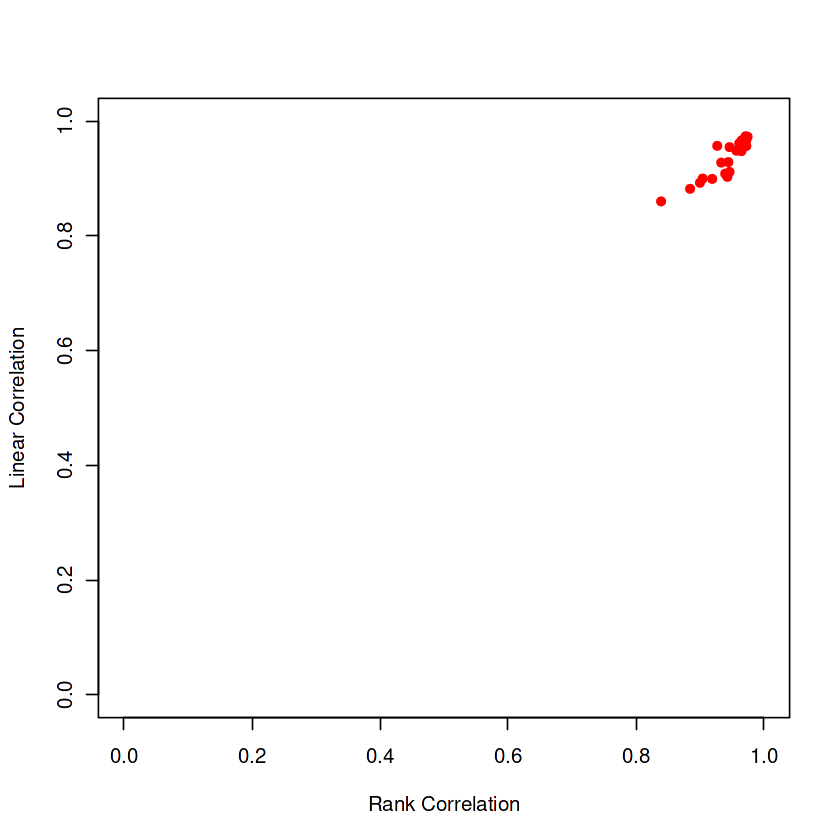

In [40]:
PCUSE=mybeer$select
COL=rep('black',length(mybeer$cor))
COL[PCUSE]='red'
plot(mybeer$cor,mybeer$lcor,pch=16,col=COL,
    xlab='Rank Correlation',ylab='Linear Correlation',xlim=c(0,1),ylim=c(0,1))

In [41]:
mybeer$seurat

An object of class Seurat 
67076 features across 11880 samples within 1 assay 
Active assay: RNA (67076 features, 1934 variable features)
 2 dimensional reductions calculated: pca, umap

In [44]:
mybeer$seurat

An object of class Seurat 
67076 features across 11880 samples within 1 assay 
Active assay: RNA (67076 features, 1934 variable features)
 2 dimensional reductions calculated: pca, umap

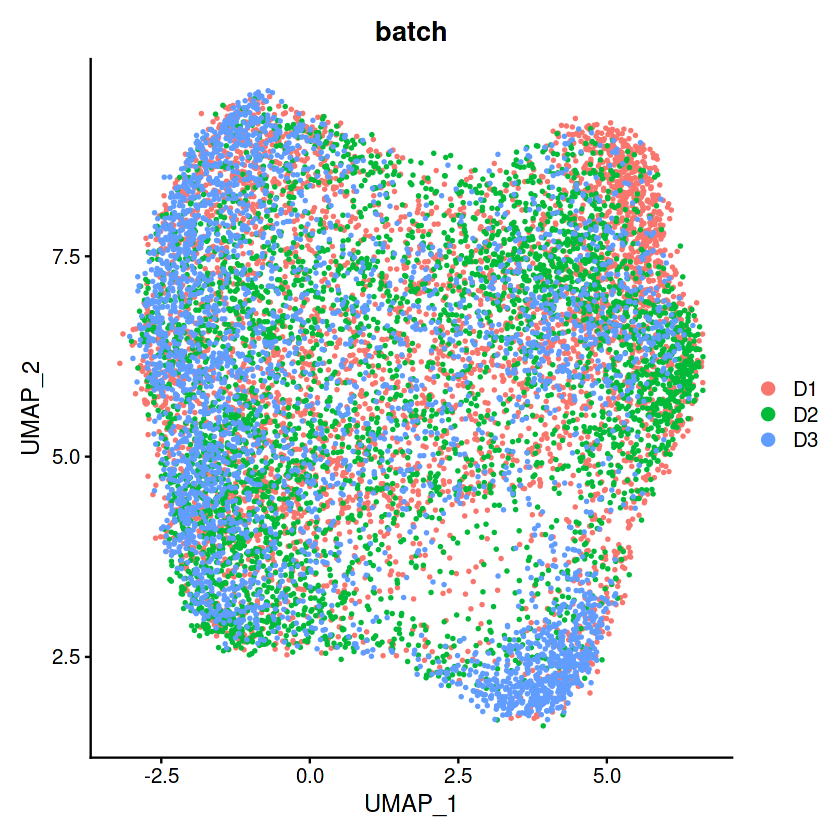

In [42]:
pbmc <- mybeer$seurat
PCUSE <- mybeer$select
pbmc@meta.data$orig.ident=char_layer
pbmc <- RunUMAP(object = pbmc, reduction='pca',dims = PCUSE, umap.method='umap-learn', metric='correlation')

DimPlot(pbmc, reduction='umap', group.by='batch', pt.size=0.5)  

In [43]:
length(unique(colnames(pbmc)))

[1] 11880

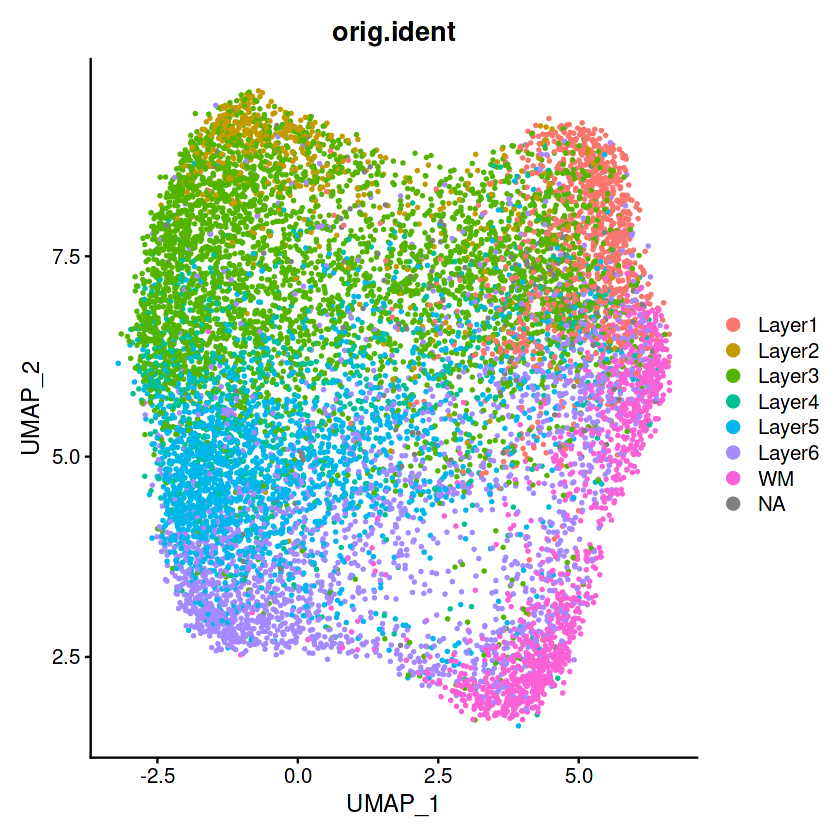

In [43]:
# pbmc <- mybeer$seurat
# PCUSE <- mybeer$select
# pbmc <- RunUMAP(object = pbmc, reduction='pca',dims = PCUSE, umap.method='umap-learn', metric='correlation')

DimPlot(pbmc, reduction='umap', group.by='orig.ident', pt.size=0.5)  

In [48]:
# pbmc <- mybeer$seurat
# PCUSE <- mybeer$select
# pbmc <- RunUMAP(object = pbmc, reduction='pca',dims = PCUSE, umap.method='umap-learn', metric='correlation')


# plot_save <- DimPlot(pbmc, reduction='umap', group.by='orig.ident', pt.size=0.5)
# ggsave('Ground_truth.png',plot_save)

In [44]:
pbmc <- FindNeighbors(object = pbmc)
pbmc <- FindClusters(object = pbmc)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 337440

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7559
Number of communities: 10
Elapsed time: 1 seconds


In [46]:
pbmc <- FindNeighbors(object = pbmc)
pbmc <- FindClusters(object = pbmc)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 337238

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7587
Number of communities: 10
Elapsed time: 2 seconds


In [45]:
# pbmc <- FindNeighbors(object = pbmc)
pbmc <- FindClusters(object = pbmc, resolution = 0.6)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 337440

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7822
Number of communities: 7
Elapsed time: 1 seconds


In [47]:
# pbmc <- FindNeighbors(object = pbmc)
pbmc <- FindClusters(object = pbmc, resolution = 0.6)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 337238

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7841
Number of communities: 8
Elapsed time: 3 seconds


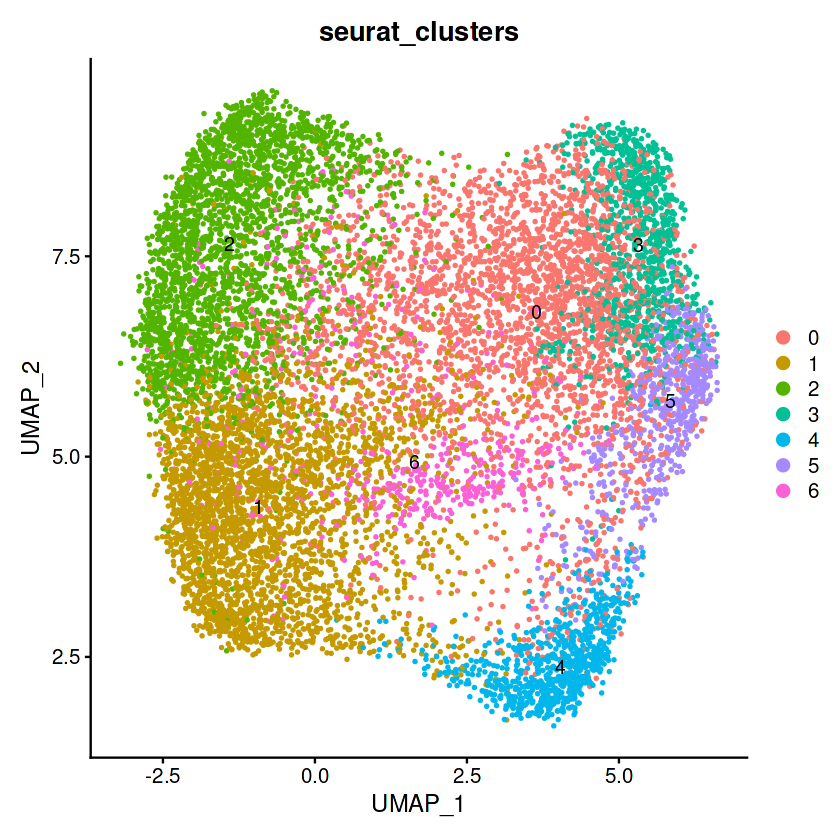

In [46]:
# pbmc <- mybeer$seurat
# PCUSE <- mybeer$select
# pbmc <- RunUMAP(object = pbmc, reduction='pca',dims = PCUSE, umap.method='umap-learn', metric='correlation')

plot_save <- DimPlot(pbmc, reduction='umap', group.by='seurat_clusters', pt.size=0.5, label=TRUE)
plot_save
# ggsave('Clustering_output.png',plot_save)

In [46]:
silhouette_seurat <- function(sobject,
                              cluster_col = "seurat_clusters",
                              dims = c(1:10)) {
    sil_obj <- cluster::silhouette(
        x = sobject@meta.data[[cluster_col]] %>%
            as.character() %>%
            as.numeric(),
        dist = Seurat::Embeddings(sobject,
                                  reduction = "pca")[, dims] %>%
        stats::dist())

    return(sil_obj)
}

In [47]:
listings = pbmc@meta.data[['batch']]
numbered_list <- as.integer(factor(listings, levels = unique(listings)))
batch_numeric <- numbered_list
names(batch_numeric) <- colnames(x=pbmc)
pbmc<- AddMetaData(
    object = pbmc,
    metadata = batch_numeric,
    col.name = 'batch_numeric'
    )
# head(x=pbmc)

In [48]:
listings = pbmc@meta.data[['orig.ident']]
numbered_list <- as.integer(factor(listings, levels = unique(listings)))
ident_numeric <- numbered_list
names(ident_numeric) <- colnames(x=pbmc)
pbmc<- AddMetaData(
    object = pbmc,
    metadata = ident_numeric,
    col.name = 'ident_numeric'
    )
# head(x=pbmc)

In [49]:
pbmc_nona_var <- pbmc[,!is.na(pbmc$orig.ident)]
pbmc_nona_var

An object of class Seurat 
67076 features across 11720 samples within 1 assay 
Active assay: RNA (67076 features, 1934 variable features)
 2 dimensional reductions calculated: pca, umap

In [52]:
pbmc_nona_var <- pbmc[,!is.na(pbmc$orig.ident)]
pbmc_nona_var

An object of class Seurat 
67076 features across 11720 samples within 1 assay 
Active assay: RNA (67076 features, 1944 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

In [50]:
length(unique(colnames(pbmc_nona_var)))

[1] 11720

In [51]:
silhouette_mean <- function(sil_obj) {
    sil_summary <- summary(sil_obj)
    return(sil_summary$avg.width)
}

In [52]:
sil_obj <- silhouette_seurat(pbmc,"batch_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] -0.009152798

In [55]:
sil_obj <- silhouette_seurat(pbmc,"batch_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] -0.009181348

In [53]:
sil_obj <- silhouette_seurat(pbmc_nona_var,"ident_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] -0.0005353921

In [56]:
sil_obj <- silhouette_seurat(pbmc_nona_var,"ident_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] -0.0008896542

In [54]:
clusts <- NULL
for (i in unique(pbmc$seurat_clusters)){
    clusts <- c(clusts, i)    
}
clusts

[1] "3" "1" "4" "6" "2" "0" "5"

In [55]:
ground <- NULL
for (i in unique(pbmc$orig.ident)){
    ground <- c(ground, i)    
}
ground

[1] "Layer1" "Layer3" "WM"     "Layer6" "Layer5" "Layer2" "Layer4" NA


Layer1 Layer2 Layer3 Layer4 Layer5 Layer6     WM 
  1090    558   3779    891   2076   2060   1266 


   0    1    2    3    4    5    6 
3093 3072 2759 1025  794  612  525 

[1] 11880

[1] 11720

[1] 11880

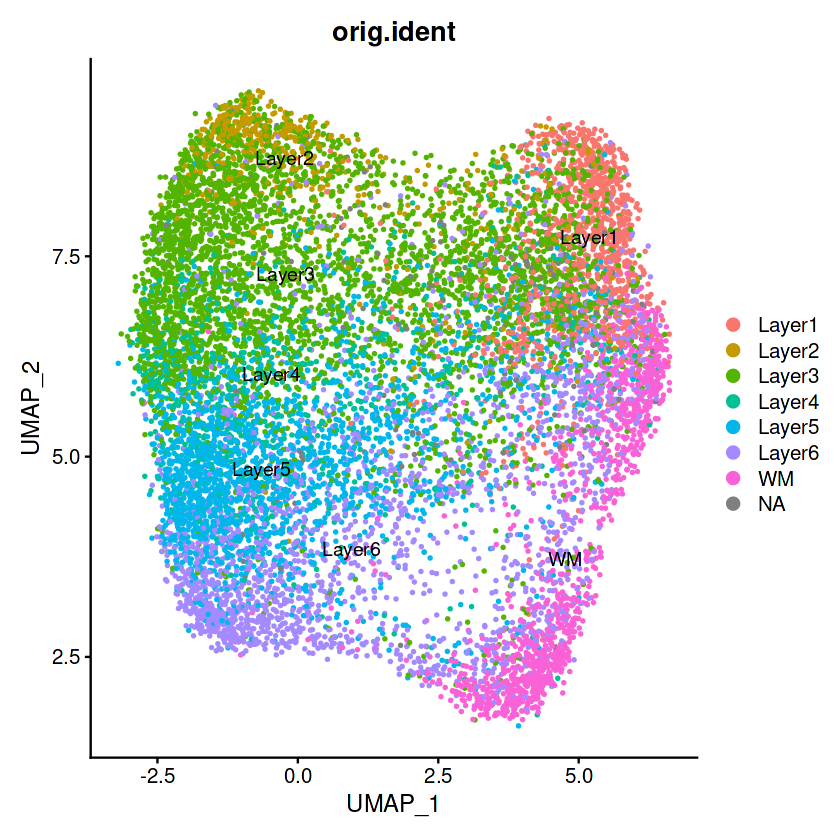

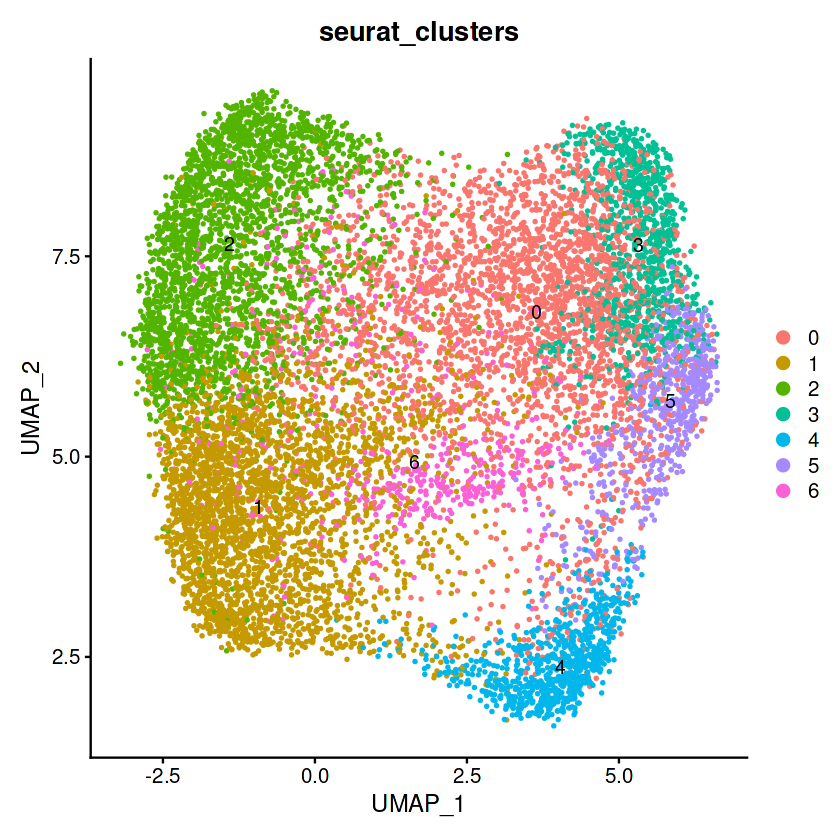

In [61]:
table(pbmc$orig.ident)
table(pbmc$seurat_clusters)
sum(table(pbmc$batch))
sum(table(pbmc$orig.ident))
sum(table(pbmc$seurat_clusters))
DimPlot(pbmc, reduction='umap',group.by='orig.ident', pt.size=0.5, label=TRUE) 
DimPlot(pbmc, reduction='umap',group.by='seurat_clusters', pt.size=0.5, label=TRUE) 

In [56]:
pbmc

An object of class Seurat 
67076 features across 11880 samples within 1 assay 
Active assay: RNA (67076 features, 1934 variable features)
 2 dimensional reductions calculated: pca, umap

In [60]:
pbmc

An object of class Seurat 
67076 features across 11880 samples within 1 assay 
Active assay: RNA (67076 features, 1944 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

In [57]:
D1_nona <- pbmc_nona_var[,pbmc_nona_var$batch=='D1']
D2_nona <- pbmc_nona_var[,pbmc_nona_var$batch=='D2']
D3_nona <- pbmc_nona_var[,pbmc_nona_var$batch=='D3']

In [58]:
score <- ARI(pbmc_nona_var$seurat_clusters,pbmc_nona_var$orig.ident)
print(c('combined ARI score: ', score))

[1] "combined ARI score: " "0.264870933530887"   


In [59]:
score <- ARI(D1_nona$seurat_clusters,D1_nona$orig.ident)
print(c('D1 ARI score: ', score))

[1] "D1 ARI score: "    "0.269165511336864"


In [60]:
score <- ARI(D2_nona$seurat_clusters,D2_nona$orig.ident)
print(c('D2 ARI score: ', score))

[1] "D2 ARI score: "   "0.27748532069322"


In [61]:
score <- ARI(D3_nona$seurat_clusters,D3_nona$orig.ident)
print(c('D3 ARI score: ', score))

[1] "D3 ARI score: "    "0.405224005514666"


In [62]:
NMI_score <- NMI(D1_nona$seurat_clusters,D1_nona$orig.ident)
print(c('D1 NMI score: ', NMI_score))

[1] "D1 NMI score: "    "0.341006460323408"


In [63]:
NMI_score <- NMI(D2_nona$seurat_clusters,D2_nona$orig.ident)
print(c('D2 NMI score: ', NMI_score))

[1] "D2 NMI score: "    "0.336113595674205"


In [64]:
NMI_score <- NMI(D3_nona$seurat_clusters,D3_nona$orig.ident)
print(c('D3 NMI score: ', NMI_score))

[1] "D3 NMI score: "    "0.427175091476473"


In [65]:
jaccard <- function(a, b) {
    intersection = length(intersect(a, b))
    union = length(a) + length(b) - intersection
    return (intersection/union)
}

In [64]:
score <- jaccard(colnames(D3_nona[ ,D3_nona$orig.ident=='Layer1']),colnames(D3_nona[ ,D3_nona$seurat_clusters=='3']))
score

[1] 0.3938462

In [65]:
score <- jaccard(colnames(D3_nona[ ,D3_nona$orig.ident=='Layer2']),colnames(D3_nona[ ,D3_nona$seurat_clusters=='1']))
score

[1] 0.002491694

In [66]:
score <- jaccard(colnames(D3_nona[ ,D3_nona$orig.ident=='Layer3']),colnames(D3_nona[ ,D3_nona$seurat_clusters=='2']))
score

[1] 0.5914221

In [67]:
score <- jaccard(colnames(D3_nona[ ,D3_nona$orig.ident=='WM']),colnames(D3_nona[ ,D3_nona$seurat_clusters=='4']))
score

[1] 0.7772436

--------BEFORE----------

In [62]:
score <- ARI(pbmc_nona_var$seurat_clusters,pbmc_nona_var$orig.ident)
print(c('combined ARI score: ', score))

[1] "combined ARI score: " "0.202380859552862"   


In [63]:
score <- ARI(D1_nona$seurat_clusters,D1_nona$orig.ident)
print(c('D1 ARI score: ', score))

[1] "D1 ARI score: "    "0.232749131032132"


In [64]:
score <- ARI(D2_nona$seurat_clusters,D2_nona$orig.ident)
print(c('D2 ARI score: ', score))

[1] "D2 ARI score: "    "0.205676616590814"


In [65]:
score <- ARI(D3_nona$seurat_clusters,D3_nona$orig.ident)
print(c('D3 ARI score: ', score))

[1] "D3 ARI score: "    "0.344249104970004"


<h2>Integrated w/ spatial w/ Batch Effect Removal Visualization</h2>

### Helper Functions:
1. Download Image Data
   * Downloads the image, scalefactors, and the tissue positions. See Fetch_Data.ipynb.
2. Add Image Data to Seurat Object.
   * Add an image to a Seurat Object.
   * Create a Spatial assay for the seurat object first before attaching the image.
3. SpatiallyVariableFeatures_workaround
   * Current implementation of SpatiallyVariableFeatures does not work. See https://github.com/satijalab/seurat/issues/7034
   * Only to be used if necessary for downstream analysis.

In [66]:
# Function for attaching image to Seurat Object
addImage <- function(object, sample_id, path, new_name=NULL) {
    image_dir <- file.path(path, sample_id)
    img <- Seurat::Read10X_Image(image.dir = image_dir)
    Seurat::DefaultAssay(object = img) <- 'Spatial'
    img <- img[colnames(x = object)]
    if (is.null(new_name)) {
        object[['image']] <- img
    } else {
        print(new_name)
        object[[new_name]] <- img
    }
    return(object)
}

In [67]:
# Using a workaround for now - https://github.com/satijalab/seurat/issues/7422
SpatiallyVariableFeatures_workaround <- function(object, assay="SCT", selection.method = "moransi") {
  #' This is work around function to replace SeuratObject::SpatiallyVariableFeatures function.
  #' return ranked list of Spatially Variable Features
  
  # Check if object is a Seurat object
  if (!inherits(object, "Seurat")) {
    stop("object must be a Seurat object")
  }

  # Check if assay is a valid assay
  if (!assay %in% names(object@assays)) {
    stop("assay must be a valid assay")
  }
  
  # Extract meta.features from the specified object and assay
  data <- object@assays[[assay]]@meta.features
  
  # Select columns starting with the provided col_prefix
  moransi_cols <- grep(paste0("^", selection.method), colnames(data), value = TRUE)

  # Filter rows where "moransi.spatially.variable" is TRUE
  filtered_data <- data[data[[paste0(selection.method, ".spatially.variable")]], moransi_cols]

  # Sort filtered data by "moransi.spatially.variable.rank" column in ascending order
  sorted_data <- filtered_data[order(filtered_data[[paste0(selection.method, ".spatially.variable.rank")]]), ]
    
  # Return row names of the sorted data frame
  rownames(sorted_data)
}

In [68]:
D1_corrected <- pbmc_nona_var[,pbmc_nona_var$batch=='D1']
D2_corrected <- pbmc_nona_var[,pbmc_nona_var$batch=='D2']
D3_corrected <- pbmc_nona_var[,pbmc_nona_var$batch=='D3']

In [69]:
removeColnameSuffix <- function(colname) {
    if (endsWith(colname, ".1") || endsWith(colname, ".2")) {
        return(gsub('.{2}$', '', colname))
    }
    return(colname)
}

In [70]:
new_D1_colnames <- lapply(colnames(D1_corrected), removeColnameSuffix)
new_D1_colnames <- simplify2array(new_D1_colnames)
D1_corrected <- RenameCells(D1_corrected, new.names = new_D1_colnames)
# colnames(D1_corrected) <- new_D1_colnames

In [71]:
new_D2_colnames <- lapply(colnames(D2_corrected), removeColnameSuffix)
new_D2_colnames <- simplify2array(new_D2_colnames)
D2_corrected <- RenameCells(D2_corrected, new.names = new_D2_colnames)

In [72]:
new_D3_colnames <- lapply(colnames(D3_corrected), removeColnameSuffix)
new_D3_colnames <- simplify2array(new_D3_colnames)
D3_corrected <- RenameCells(D3_corrected, new.names = new_D3_colnames)

In [73]:
D1_corrected_spatial_assay <- CreateAssayObject(counts = D1_corrected[["RNA"]]@data)
D1_corrected[["Spatial"]] <- D1_corrected_spatial_assay
D2_corrected_spatial_assay <- CreateAssayObject(counts = D2_corrected[["RNA"]]@data)
D2_corrected[["Spatial"]] <- D2_corrected_spatial_assay
D3_corrected_spatial_assay <- CreateAssayObject(counts = D3_corrected[["RNA"]]@data)
D3_corrected[["Spatial"]] <- D3_corrected_spatial_assay

In [74]:
# Set the download dir to the directory where the image information of the samples are downloaded. "dataset/samples"
data_dir <- 'dataset'
sample_dir <- 'samples'
download_dir <- file.path(data_dir, sample_dir)

In [75]:
sample_507_name <- '151507'
D1_corrected <- addImage(D1_corrected, sample_507_name, download_dir, new_name=glue("image{sample_507_name}"))
sample_672_name <- '151672'
D2_corrected <- addImage(D2_corrected, sample_672_name, download_dir, new_name=glue("image{sample_672_name}"))
sample_673_name <- '151673'
D3_corrected <- addImage(D3_corrected, sample_673_name, download_dir, new_name=glue("image{sample_673_name}"))

image151507
image151672
image151673


In [76]:
DefaultAssay(D1_corrected) <- "Spatial"
DefaultAssay(D2_corrected) <- "Spatial"
DefaultAssay(D3_corrected) <- "Spatial"

In [77]:
D1_corrected
D2_corrected
D3_corrected

An object of class Seurat 
134152 features across 4221 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image151507

An object of class Seurat 
134152 features across 3888 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image151672

An object of class Seurat 
134152 features across 3611 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image151673

In [79]:
D1_corrected
D2_corrected
D3_corrected

An object of class Seurat 
134152 features across 4221 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

An object of class Seurat 
134152 features across 3888 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
134152 features across 3611 samples within 2 assays 
Active assay: Spatial (67076 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

In [78]:
# Adjust plot size
options(repr.plot.width = 30, repr.plot.height = 10)

In [ ]:
D1_corrected_plot_ncount <- SpatialFeaturePlot(D1_corrected, features = "nCount_Spatial") + theme(legend.position = "right")
D1_corrected_plot_layers <- SpatialDimPlot(D1_corrected, group.by='orig.ident', label = TRUE, label.size = 9) + theme(legend.position = "right")
D1_corrected_plot_seurat <- SpatialDimPlot(D1_corrected, group.by='seurat_clusters', label = TRUE, label.size = 9) + theme(legend.position = "right")
wrap_plots(D1_corrected_plot_ncount, D1_corrected_plot_layers, D1_corrected_plot_seurat)

In [ ]:
g <- ggplot_build(D1_corrected_plot_layers)
cols <- unique(g$data[[1]]["fill"])
barplot(c(5,5,5,5,5,5,5), col = c(cols[1,1], cols[2,1], cols[3,1], cols[4,1], cols[5,1], cols[6,1], cols[7,1] ))

In [81]:
layers_col <- c('WM'=cols[3,1], 'Layer1'=cols[1,1] ,'Layer2'=cols[6,1], 'Layer3'=cols[2,1], 'Layer4'=cols[7,1], 'Layer5'=cols[5,1], 'Layer6'=cols[4,1])
colors_507 <- c('4'=cols[3,1], '3'=cols[1,1], '6'=cols[6,1], '2'=cols[2,1], '0'=cols[7,1], '1'=cols[5,1], '5'=cols[4,1])
colors_672 <- c('5'=cols[3,1], '3'=cols[1,1], '2'=cols[6,1], '0'=cols[2,1], '6'=cols[7,1], '1'=cols[5,1], '4'=cols[4,1])
colors_673 <- c('4'=cols[3,1], '3'=cols[1,1], '5'=cols[6,1], '2'=cols[2,1], '6'=cols[7,1], '1'=cols[5,1], '0'=cols[4,1]) 

In [82]:
layers_col <- c('WM'=cols[3,1], 'Layer1'=cols[1,1] ,'Layer2'=cols[6,1], 'Layer3'=cols[2,1], 'Layer4'=cols[7,1], 'Layer5'=cols[5,1], 'Layer6'=cols[4,1])
b_colors_507 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '2'=cols[7,1], '0'=cols[5,1], '6'=cols[4,1])
b_colors_672 <- c('6'=cols[3,1], '4'=cols[1,1] ,'5'=cols[6,1], '1'=cols[2,1], '3'=cols[7,1], '2'=cols[5,1], '0'=cols[4,1])
b_colors_673 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '6'=cols[7,1], '0'=cols[5,1], '2'=cols[4,1]) 

In [146]:
to_test <- colnames(D3_nona[ ,D3_nona$orig.ident=="Layer1"])
for (i in unique(D3_nona$seurat_clusters)){
score <- jaccard(to_test, colnames(D3_nona[ ,D3_nona$seurat_clusters==i]))
print(paste0(i, " - ",score))
}

[1] "2 - 0.00214899713467049"
[1] "0 - 0.171388101983003"
[1] "4 - 0.00230680507497117"
[1] "6 - 0.0178117048346056"
[1] "5 - 0.0327380952380952"
[1] "1 - 0.000815660685154976"
[1] "3 - 0.393846153846154"


In [305]:
to_test <- colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$orig.ident=="Layer4"])
for (i in unique(D3_nospatial_nocorrection$seurat_clusters)){
score <- jaccard(to_test, colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$seurat_clusters==i]))
print(paste0(i, " - ",score))
}

[1] "4 - 0"
[1] "5 - 0"
[1] "3 - 0.0423452768729642"
[1] "0 - 0.0821621621621622"
[1] "2 - 0.0435967302452316"
[1] "1 - 0.0810546875"
[1] "6 - 0.00371747211895911"


In [306]:
to_test <- colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$seurat_clusters=='6'])
for (i in unique(D3_nospatial_nocorrection$orig.ident)){
score <- jaccard(colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$orig.ident==i]), to_test)
print(paste0(i, " - ",score))
}

[1] "Layer3 - 0.00192492781520693"
[1] "Layer1 - 0.0416666666666667"
[1] "WM - 0.00533807829181495"
[1] "Layer5 - 0.00415512465373961"
[1] "Layer6 - 0.0391061452513966"
[1] "Layer2 - 0.0066006600660066"
[1] "Layer4 - 0.00371747211895911"


In [ ]:
D3_corrected_plot_ncount <- SpatialFeaturePlot(D3_corrected, features = "nCount_Spatial") + theme(legend.position = "right")
D3_corrected_plot_layers <- SpatialDimPlot(D3_corrected, group.by='orig.ident', label = TRUE, label.size = 7, image.alpha=0.3) + theme(legend.position = "right") + scale_fill_manual(values = layers_col)
D3_corrected_plot_seurat <- SpatialDimPlot(D3_corrected, group.by='seurat_clusters', label = TRUE, label.size = 7, image.alpha=0.3) + theme(legend.position = "right") + scale_fill_manual(values = colors_673)
wrap_plots(D3_corrected_plot_ncount, D3_corrected_plot_layers, D3_corrected_plot_seurat)

In [263]:
# ggsave('Clustering_672_nolabel.png',D2_corrected_plot_seurat)

Saving 6.67 x 6.67 in image


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


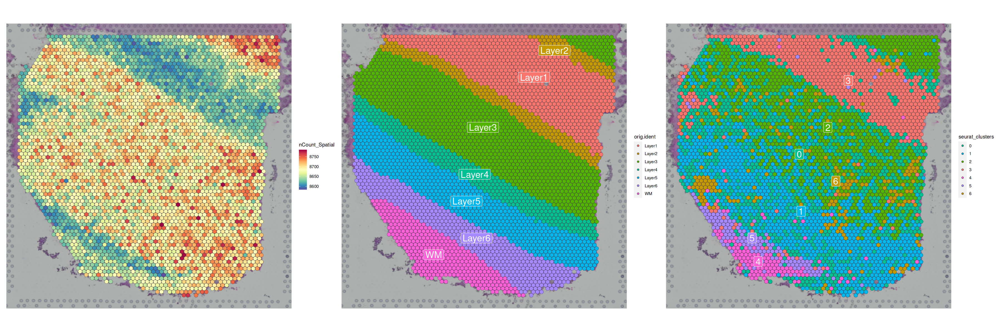

In [83]:
D1_corrected_plot_ncount <- SpatialFeaturePlot(D1_corrected, features = "nCount_Spatial") + theme(legend.position = "right")
D1_corrected_plot_layers <- SpatialDimPlot(D1_corrected, group.by='orig.ident', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = layers_col)
D1_corrected_plot_seurat <- SpatialDimPlot(D1_corrected, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = colors_507)
wrap_plots(D1_corrected_plot_ncount, D1_corrected_plot_layers, D1_corrected_plot_seurat)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


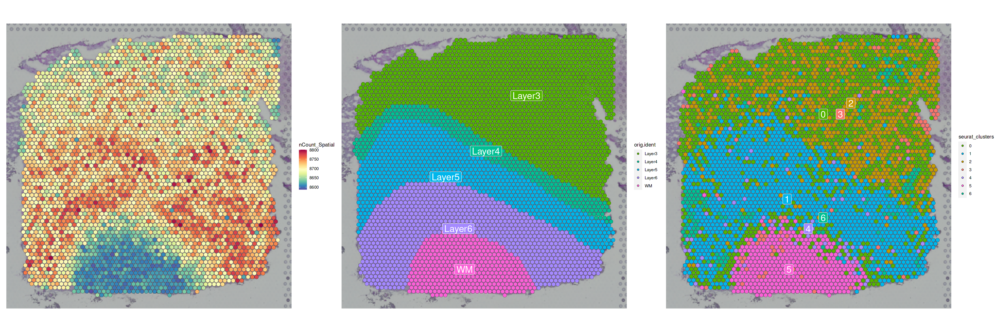

In [84]:
D2_corrected_plot_ncount <- SpatialFeaturePlot(D2_corrected, features = "nCount_Spatial") + theme(legend.position = "right")
D2_corrected_plot_layers <- SpatialDimPlot(D2_corrected, group.by='orig.ident', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = layers_col)
D2_corrected_plot_seurat <- SpatialDimPlot(D2_corrected, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = colors_672)
wrap_plots(D2_corrected_plot_ncount, D2_corrected_plot_layers, D2_corrected_plot_seurat)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


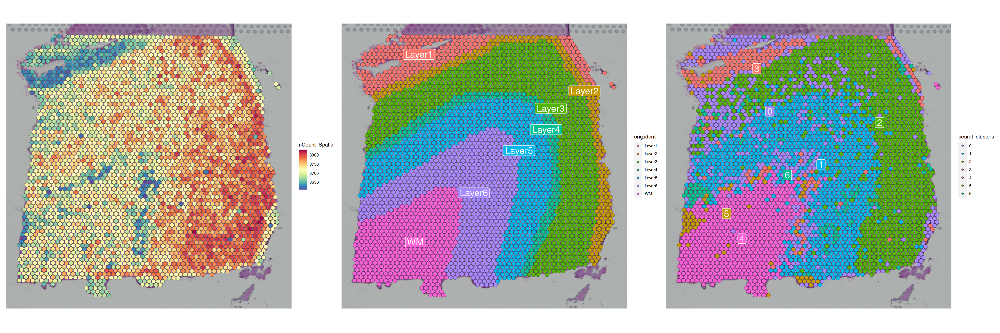

In [85]:
D3_corrected_plot_ncount <- SpatialFeaturePlot(D3_corrected, features = "nCount_Spatial") + theme(legend.position = "right")
D3_corrected_plot_layers <- SpatialDimPlot(D3_corrected, group.by='orig.ident', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = layers_col)
D3_corrected_plot_seurat <- SpatialDimPlot(D3_corrected, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = colors_673)
wrap_plots(D3_corrected_plot_ncount, D3_corrected_plot_layers, D3_corrected_plot_seurat)

In [1]:
D3_corrected_plot_ncount <- SpatialFeaturePlot(D3_corrected, features = "nCount_Spatial", image = NULL) + theme(legend.position = "right")
D3_corrected_plot_layers <- SpatialDimPlot(D3_corrected, group.by='orig.ident', label = TRUE, label.size = 7) + theme(legend.position = "right")
D3_corrected_plot_seurat <- SpatialDimPlot(D3_corrected, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right")
wrap_plots(D3_corrected_plot_ncount, D3_corrected_plot_layers, D3_corrected_plot_seurat)

ERROR: Error in SpatialFeaturePlot(D3_corrected, features = "nCount_Spatial", : could not find function "SpatialFeaturePlot"


In [ ]:
options(repr.plot.width = 30, repr.plot.height = 20)
gene1 <- SpatialFeaturePlot(D3_corrected, features = "nCount_Spatial") + theme(legend.position = "right", legend.key.size = unit(2,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene2 <- SpatialFeaturePlot(D3_corrected, features = "nCount_RNA") + theme(legend.position = "right", legend.key.size = unit(2,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene3 <- SpatialFeaturePlot(D3_corrected, features = "nFeature_Spatial") + theme(legend.position = "right", legend.key.size = unit(2,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene4 <- SpatialFeaturePlot(D3_corrected, features = "nFeature_RNA") + theme(legend.position = "right", legend.key.size = unit(2,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
wrap_plots(gene1, gene2, gene3, gene4)
# ENSG00000243485

In [ ]:
options(repr.plot.width = 30, repr.plot.height = 20)
gene1 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000101439") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene2 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000087250") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene3 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000120885") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene4 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000198763") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene5 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000198888") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))
gene6 <- SpatialFeaturePlot(D3_corrected, features = "ENSG00000198899") + theme(legend.position = "right", legend.key.size = unit(1.5,'cm'), legend.title = element_text(size=14), legend.text = element_text(size=12))

wrap_plots(gene1, gene2, gene3, gene4, gene5, gene6)
# ENSG00000243485

In [ ]:
options(repr.plot.width = 30, repr.plot.height = 20)
wrap_plots(D1_corrected_plot_layers, D2_corrected_plot_layers, D3_corrected_plot_layers, D1_corrected_plot_seurat, D2_corrected_plot_seurat, D3_corrected_plot_seurat, ncol=3, nrow=2)

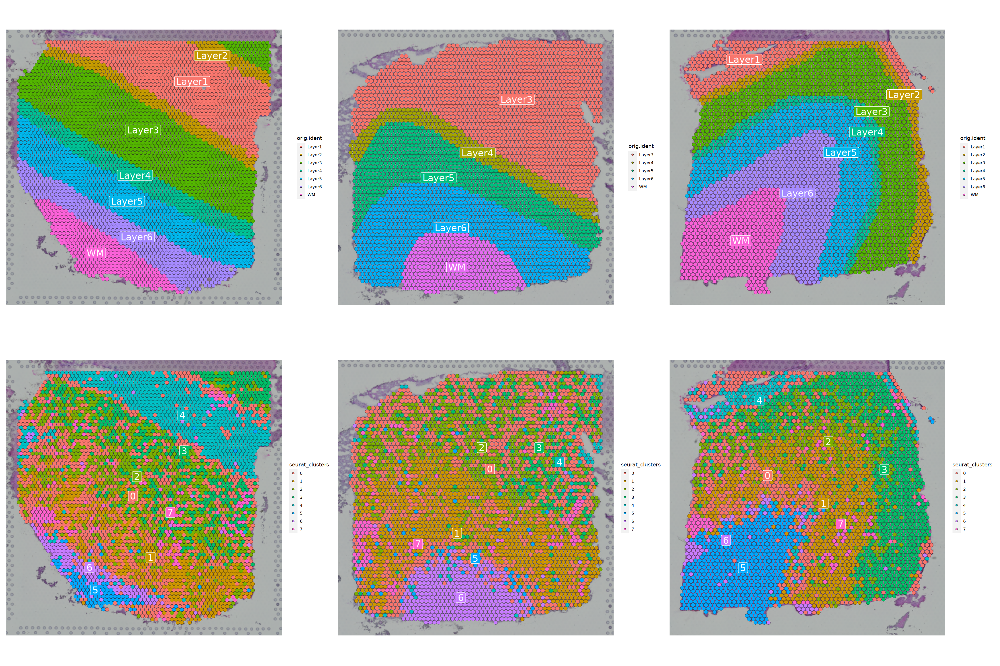

In [84]:
options(repr.plot.width = 30, repr.plot.height = 20)
wrap_plots(D1_corrected_plot_layers, D2_corrected_plot_layers, D3_corrected_plot_layers, D1_corrected_plot_seurat, D2_corrected_plot_seurat, D3_corrected_plot_seurat, ncol=3, nrow=2)

In [85]:
dlfpc.merge <- merge(D1_corrected, D2_corrected)
dlfpc.merge <- merge(dlfpc.merge, D3_corrected)

Warning message:
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [86]:
pbmc_nona_var@reductions$umap

In [87]:
dlfpc.merge@reductions

list()

In [88]:
DefaultAssay(dlfpc.merge) <- "Spatial"

In [89]:
legend_theme <- theme(legend.title = element_text(size=30), legend.text = element_text(size=20))

In [90]:
D1_orig <- SpatialDimPlot(dlfpc.merge, label.size=4, images="image_151507", group.by="orig.ident")
D2_orig <- SpatialDimPlot(dlfpc.merge, images="image_151672", group.by="orig.ident")
D3_orig <- SpatialDimPlot(dlfpc.merge, images="image_151673", group.by="orig.ident")
D1_seurat <- SpatialDimPlot(dlfpc.merge, images="image_151507", group.by="seurat_clusters")
D2_seurat <- SpatialDimPlot(dlfpc.merge, images="image_151672", group.by="seurat_clusters")
D3_seurat <- SpatialDimPlot(dlfpc.merge, images="image_151673", group.by="seurat_clusters")

In [ ]:
options(repr.plot.width = 21, repr.plot.height = 14)
wrap_plots(D1_orig, D2_orig, D3_orig, D1_seurat, D2_seurat, D3_seurat, ncol=3)
options(repr.plot.width = 7, repr.plot.height = 7)

In [92]:
output_dir <- "output"
output_default_nocorr_rna <- "default_nocorr_rna"
output_default_nocorr_sct <- "default_nocorr_sct"
output_spatial_rna <- "spatial_nocorr_rna"
output_spatial_sct <- "spatial_nocorr_sct"
output_default_corrected <- "default_corrected"
output_spatial_corrected <- "spatial_corrected"
output_orig <- "orig"
output_D1 <- "D1_single"
output_D2 <- "D2_single"
output_D3 <- "D3_single"
output_subdirs <- list(output_default_nocorr_rna, output_default_nocorr_sct, 
                    output_spatial_rna, output_spatial_sct, 
                    output_default_corrected, output_spatial_corrected,
                    output_D1, output_D2, output_D3,
                    output_orig)
download_dir <- file.path(data_dir, sample_dir)
if (!file.exists(output_dir)) {
    dir.create(output_dir)
}

for (subdir in output_subdirs) {
    subdir_path <- file.path(output_dir,subdir)
    if (!file.exists(subdir_path)) {
        dir.create(subdir_path)    
    }
}

In [93]:
orig_path <- file.path(output_dir, output_orig)

jpeg(filename = file.path(orig_path, glue("{output_orig}_151507.jpg")), height = 400, width = 470, quality = 100)
D1_orig
dev.off()
jpeg(filename = file.path(orig_path, glue("{output_orig}_151672.jpg")), height = 400, width = 470, quality = 100)
D2_orig
dev.off()
jpeg(filename = file.path(orig_path, glue("{output_orig}_151673.jpg")), height = 400, width = 470, quality = 100)
D3_orig
dev.off()

png 
  2

png 
  2

png 
  2

In [94]:
gsi_path <- file.path(output_dir, output_spatial_corrected)

jpeg(filename = file.path(gsi_path, glue("{output_spatial_corrected}_151507.jpg")), height = 400, width = 500, quality = 100)
D1_seurat
dev.off()
jpeg(filename = file.path(gsi_path, glue("{output_spatial_corrected}_151672.jpg")), height = 400, width = 500, quality = 100)
D2_seurat
dev.off()
jpeg(filename = file.path(gsi_path, glue("{output_spatial_corrected}_151673.jpg")), height = 400, width = 500, quality = 100)
D3_seurat
dev.off()

png 
  2

png 
  2

png 
  2

In [ ]:
options(repr.plot.width = 21, repr.plot.height = 7)
SpatialDimPlot(dlfpc.merge, group.by="seurat_clusters")

In [96]:
length(rownames(dlfpc.merge[["image_151507"]]@coordinates))

[1] 4221

<h2>End of Integrated w/ spatial w/ Batch Effect Removal Visualization</h2>

<h2>Integrated w/o spatial info w/o BE Removal</h2>
(No integrated spatial information, no batch effect removal)

Warning message:
“Non-unique cell names (colnames) present in the input matrix, making unique”
Centering and scaling data matrix

PC_ 1 
Positive:  ENSG00000187094 
Negative:  ENSG00000168314 



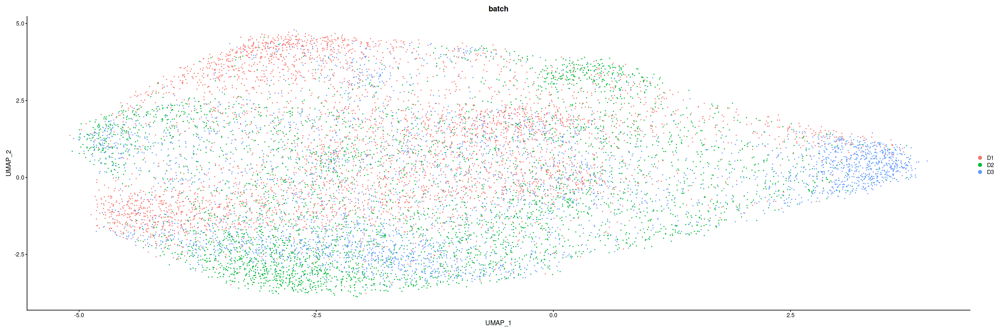

In [98]:
pbmc_batch=CreateSeuratObject(counts = DATA_default, min.cells = 0, min.features = 0, project = "ALL") 
pbmc_batch@meta.data$batch=BATCH
pbmc_batch@meta.data$orig.ident=char_layer
pbmc_batch=FindVariableFeatures(object = pbmc_batch, selection.method = "vst", nfeatures = 2000)   
# VariableFeatures(object = pbmc_batch)
pbmc_batch <- NormalizeData(object = pbmc_batch, normalization.method = "LogNormalize", scale.factor = 10000)
pbmc_batch <- ScaleData(object = pbmc_batch, features = VariableFeatures(object = pbmc_batch))
pbmc_batch <- RunPCA(object = pbmc_batch, seed.use=123, npcs=50, features = VariableFeatures(object = pbmc_batch), ndims.print=1,nfeatures.print=1)
pbmc_batch <- RunUMAP(pbmc_batch, dims = 1:50, seed.use = 123,n.components=2, umap.method = "umap-learn",  metric="correlation")
DimPlot(pbmc_batch, reduction='umap', group.by='batch', pt.size=0.1) 

In [99]:
pbmc_batch <- FindNeighbors(object = pbmc_batch)
pbmc_batch <- FindClusters(object = pbmc_batch, resolution = 0.425)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 340365

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8145
Number of communities: 8
Elapsed time: 1 seconds


In [100]:
pbmc_batch <- FindClusters(object = pbmc_batch, resolution = 0.4)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 11880
Number of edges: 340365

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8180
Number of communities: 7
Elapsed time: 1 seconds


In [ ]:
plot1 <- DimPlot(pbmc_batch, reduction='umap', group.by='orig.ident', pt.size=0.1)
plot2 <- DimPlot(pbmc_batch, reduction='umap', group.by='seurat_clusters', pt.size=0.1) 
plot1

In [101]:
listings = pbmc_batch@meta.data[['batch']]
numbered_list <- as.integer(factor(listings, levels = unique(listings)))
batch_numeric <- numbered_list
names(batch_numeric) <- colnames(x=pbmc_batch)
pbmc_batch<- AddMetaData(
    object = pbmc_batch,
    metadata = batch_numeric,
    col.name = 'batch_numeric'
    )
# head(x=pbmc)

In [102]:
listings = pbmc_batch@meta.data[['orig.ident']]
numbered_list <- as.integer(factor(listings, levels = unique(listings)))
ident_numeric <- numbered_list
names(ident_numeric) <- colnames(x=pbmc_batch)
pbmc_batch<- AddMetaData(
    object = pbmc_batch,
    metadata = ident_numeric,
    col.name = 'ident_numeric'
    )
# head(x=pbmc)

In [103]:
nona_batch <- pbmc_batch[,!is.na(pbmc_batch$orig.ident)]
nona_batch

An object of class Seurat 
33538 features across 11720 samples within 1 assay 
Active assay: RNA (33538 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [104]:
D1_nona_batch <- nona_batch[,nona_batch$batch=='D1']
D2_nona_batch <- nona_batch[,nona_batch$batch=='D2']
D3_nona_batch <- nona_batch[,nona_batch$batch=='D3']

In [102]:
sil_obj <- silhouette_seurat(pbmc_batch,"seurat_clusters",PCUSE)
silhouette_mean(sil_obj)

[1] 0.03574944

In [103]:
sil_obj <- silhouette_seurat(pbmc_batch,"batch_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] 0.002238919

In [104]:
sil_obj <- silhouette_seurat(nona_batch,"ident_numeric",PCUSE)
silhouette_mean(sil_obj)

[1] -0.01887955

In [105]:
score <- ARI(nona_batch$seurat_clusters, nona_batch$orig.ident)
print(c('before batch effect removal combined ARI score: ', score))

[1] "before batch effect removal combined ARI score: "
[2] "0.166154785399512"                               


In [106]:
score <- ARI(D1_nona_batch$seurat_clusters, D1_nona_batch$orig.ident)
print(c('before batch effect removal D1 ARI score: ', score))

[1] "before batch effect removal D1 ARI score: "
[2] "0.25502040118585"                          


In [107]:
score <- ARI(D2_nona_batch$seurat_clusters, D2_nona_batch$orig.ident)
print(c('before batch effect removal D2 ARI score: ', score))

[1] "before batch effect removal D2 ARI score: "
[2] "0.179005170773573"                         


In [108]:
score <- ARI(D3_nona_batch$seurat_clusters, D3_nona_batch$orig.ident)
print(c('before batch effect removal D3 ARI score: ', score))

[1] "before batch effect removal D3 ARI score: "
[2] "0.225855958302328"                         


---------------

In [108]:
score <- ARI(nona_batch$seurat_clusters, nona_batch$orig.ident)
print(c('before batch effect removal combined ARI score: ', score))

[1] "before batch effect removal combined ARI score: "
[2] "0.166154785399512"                               


In [109]:
score <- ARI(D1_nona_batch$seurat_clusters, D1_nona_batch$orig.ident)
print(c('before batch effect removal D1 ARI score: ', score))

[1] "before batch effect removal D1 ARI score: "
[2] "0.25502040118585"                          


In [110]:
score <- ARI(D2_nona_batch$seurat_clusters, D2_nona_batch$orig.ident)
print(c('before batch effect removal D2 ARI score: ', score))

[1] "before batch effect removal D2 ARI score: "
[2] "0.179005170773573"                         


In [111]:
score <- ARI(D3_nona_batch$seurat_clusters, D3_nona_batch$orig.ident)
print(c('before batch effect removal D3 ARI score: ', score))

[1] "before batch effect removal D3 ARI score: "
[2] "0.225855958302328"                         


In [112]:
default_integrated_markers <- FindAllMarkers(object = pbmc_batch, logfc.threshold=0.1)
head(default_integrated_markers)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6



,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
ENSG00000124935,0.000000e+00,0.7254575,0.840,0.426,0.000000e+00,0,ENSG00000124935
ENSG00000110484,0.000000e+00,0.6457918,0.943,0.631,0.000000e+00,0,ENSG00000110484
ENSG00000160182,7.997888e-158,0.5797594,0.469,0.207,2.682332e-153,0,ENSG00000160182
ENSG00000211592,1.161469e-106,0.5791045,0.516,0.294,3.895333e-102,0,ENSG00000211592
ENSG00000160862,1.414413e-102,0.4270379,0.386,0.183,4.743657e-98,0,ENSG00000160862
ENSG00000185499,3.894779e-89,0.3207741,0.617,0.377,1.306231e-84,0,ENSG00000185499


In [113]:
# default thres
table(default_integrated_markers$cluster)
sum(table(default_integrated_markers$cluster))


   0    1    2    3    4    5    6 
 576 1576  435  766 2861 3735 3575 

[1] 13524

In [114]:
# 0.1 thres
table(default_integrated_markers$cluster)
sum(table(default_integrated_markers$cluster))


   0    1    2    3    4    5    6 
 576 1576  435  766 2861 3735 3575 

[1] 13524

In [115]:
write.csv(default_integrated_markers,'no_spatial_no_ber_01_threshold.csv')

<h2>Integrated w/o spatial info w/o BE Removal Visualization</h2>

In [105]:
D1_nospatial_nocorrection <- nona_batch[,nona_batch$batch=='D1']
D2_nospatial_nocorrection <- nona_batch[,nona_batch$batch=='D2']
D3_nospatial_nocorrection <- nona_batch[,nona_batch$batch=='D3']

In [106]:
new_D1_colnames <- lapply(colnames(D1_nospatial_nocorrection), removeColnameSuffix)
new_D1_colnames <- simplify2array(new_D1_colnames)
D1_nospatial_nocorrection <- RenameCells(D1_nospatial_nocorrection, new.names = new_D1_colnames)

In [107]:
new_D2_colnames <- lapply(colnames(D2_nospatial_nocorrection), removeColnameSuffix)
new_D2_colnames <- simplify2array(new_D2_colnames)
D2_nospatial_nocorrection <- RenameCells(D2_nospatial_nocorrection, new.names = new_D2_colnames)

In [108]:
new_D3_colnames <- lapply(colnames(D3_nospatial_nocorrection), removeColnameSuffix)
new_D3_colnames <- simplify2array(new_D3_colnames)
D3_nospatial_nocorrection <- RenameCells(D3_nospatial_nocorrection, new.names = new_D3_colnames)

In [109]:
D1_nospatial_nocorrection[["Spatial"]] <- CreateAssayObject(counts = D1_nospatial_nocorrection[["RNA"]]@data)
D2_nospatial_nocorrection[["Spatial"]] <- CreateAssayObject(counts = D2_nospatial_nocorrection[["RNA"]]@data)
D3_nospatial_nocorrection[["Spatial"]] <- CreateAssayObject(counts = D3_nospatial_nocorrection[["RNA"]]@data)

In [110]:
sample_507_name <- '151507'
D1_nospatial_nocorrection <- addImage(D1_nospatial_nocorrection, sample_507_name, download_dir, new_name=glue("image_{sample_507_name}"))
sample_672_name <- '151672'
D2_nospatial_nocorrection <- addImage(D2_nospatial_nocorrection, sample_672_name, download_dir, new_name=glue("image_{sample_672_name}"))
sample_673_name <- '151673'
D3_nospatial_nocorrection <- addImage(D3_nospatial_nocorrection, sample_673_name, download_dir, new_name=glue("image_{sample_673_name}"))

image_151507


Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from image_151507_ to image151507_”


image_151672


Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from image_151672_ to image151672_”


image_151673


Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from image_151673_ to image151673_”


In [111]:
DefaultAssay(D1_nospatial_nocorrection) <- "Spatial"
DefaultAssay(D2_nospatial_nocorrection) <- "Spatial"
DefaultAssay(D3_nospatial_nocorrection) <- "Spatial"

In [112]:
D1_nospatial_nocorrection
D2_nospatial_nocorrection
D3_nospatial_nocorrection

An object of class Seurat 
67076 features across 4221 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

An object of class Seurat 
67076 features across 3888 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
67076 features across 3611 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

In [122]:
D1_nospatial_nocorrection
D2_nospatial_nocorrection
D3_nospatial_nocorrection

An object of class Seurat 
67076 features across 4221 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

An object of class Seurat 
67076 features across 3888 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
67076 features across 3611 samples within 2 assays 
Active assay: Spatial (33538 features, 0 variable features)
 2 layers present: counts, data
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

In [113]:
layers_col <- c('WM'=cols[3,1], 'Layer1'=cols[1,1] ,'Layer2'=cols[6,1], 'Layer3'=cols[2,1], 'Layer4'=cols[7,1], 'Layer5'=cols[5,1], 'Layer6'=cols[4,1])
b_colors_507 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '2'=cols[7,1], '0'=cols[5,1], '6'=cols[4,1])
b_colors_672 <- c('6'=cols[3,1], '4'=cols[1,1] ,'5'=cols[6,1], '1'=cols[2,1], '3'=cols[7,1], '2'=cols[5,1], '0'=cols[4,1])
b_colors_673 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '6'=cols[7,1], '0'=cols[5,1], '2'=cols[4,1]) 

In [178]:
to_test <- colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$orig.ident=="Layer2"])
for (i in unique(D3_nospatial_nocorrection$seurat_clusters)){
score <- jaccard(to_test, colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$seurat_clusters==i]))
print(paste0(i, " - ",score))
}

[1] "4 - 0.0385487528344671"
[1] "5 - 0"
[1] "3 - 0.112026359143328"
[1] "0 - 0.100956429330499"
[1] "2 - 0.0100882723833544"
[1] "1 - 0.0583873957367933"
[1] "6 - 0.0066006600660066"


In [177]:
to_test <- colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$seurat_clusters=='6'])
for (i in unique(D3_nospatial_nocorrection$orig.ident)){
score <- jaccard(colnames(D3_nospatial_nocorrection[ ,D3_nospatial_nocorrection$orig.ident==i]), to_test)
print(paste0(i, " - ",score))
}

[1] "Layer3 - 0.00192492781520693"
[1] "Layer1 - 0.0416666666666667"
[1] "WM - 0.00533807829181495"
[1] "Layer5 - 0.00415512465373961"
[1] "Layer6 - 0.0391061452513966"
[1] "Layer2 - 0.0066006600660066"
[1] "Layer4 - 0.00371747211895911"


In [173]:
to_test <- colnames(D3_corrected[ ,D3_corrected$orig.ident=="Layer2"])
for (i in unique(D3_corrected$seurat_clusters)){
score <- jaccard(to_test, colnames(D3_corrected[ ,D3_corrected$seurat_clusters==i]))
print(paste0(i, " - ",score))
}

[1] "2 - 0.147254575707155"
[1] "0 - 0.0745672436750999"
[1] "4 - 0"
[1] "6 - 0.0160427807486631"
[1] "5 - 0"
[1] "1 - 0.00249169435215947"
[1] "3 - 0.0260663507109005"


In [174]:
to_test <- colnames(D3_corrected[ ,D3_corrected$seurat_clusters=='6'])
for (i in unique(D3_corrected$orig.ident)){
score <- jaccard(colnames(D3_corrected[ ,D3_corrected$orig.ident==i]), to_test)
print(paste0(i, " - ",score))
}

[1] "Layer3 - 0.0229147571035747"
[1] "Layer1 - 0.0178117048346056"
[1] "WM - 0"
[1] "Layer5 - 0.0695187165775401"
[1] "Layer6 - 0.0314861460957179"
[1] "Layer2 - 0.0160427807486631"
[1] "Layer4 - 0.036036036036036"


In [209]:
library(caret)

Loading required package: lattice



In [114]:
D1_nospatial_nocorrection_plot_seurat <- SpatialDimPlot(D1_nospatial_nocorrection, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = b_colors_507)
D2_nospatial_nocorrection_plot_seurat <- SpatialDimPlot(D2_nospatial_nocorrection, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = b_colors_672)
D3_nospatial_nocorrection_plot_seurat <- SpatialDimPlot(D3_nospatial_nocorrection, group.by='seurat_clusters', label = TRUE, label.size = 7) + theme(legend.position = "right") + scale_fill_manual(values = b_colors_673)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


In [171]:
# ggsave("Truth_673_label.png",D3_corrected_plot_layers)

Saving 6.67 x 6.67 in image


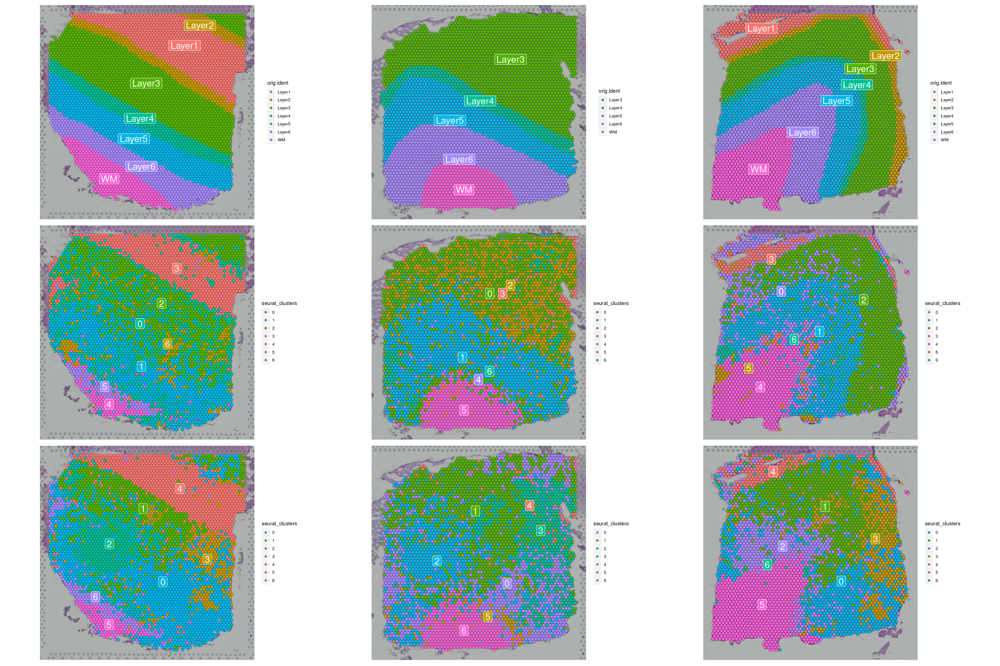

In [168]:
options(repr.plot.width = 30, repr.plot.height = 20)
wrap_plots(D1_corrected_plot_layers, D2_corrected_plot_layers, D3_corrected_plot_layers, 
           D1_corrected_plot_seurat, D2_corrected_plot_seurat, D3_corrected_plot_seurat, 
           D1_nospatial_nocorrection_plot_seurat, D2_nospatial_nocorrection_plot_seurat, D3_nospatial_nocorrection_plot_seurat, ncol=3, nrow=3)

In [186]:
options(repr.plot.width = 30, repr.plot.height = 10)
clust_subset_plot_1 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 4],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_2 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 3],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_3 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 5],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_4 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 2],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_5 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 6],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_6 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 1],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")
clust_subset_plot_7 <- SpatialDimPlot(D3_corrected[, D3_corrected$seurat_clusters == 0],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = colors_673) + theme(legend.position = "none")

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


In [113]:
layers_col <- c('WM'=cols[3,1], 'Layer1'=cols[1,1] ,'Layer2'=cols[6,1], 'Layer3'=cols[2,1], 'Layer4'=cols[7,1], 'Layer5'=cols[5,1], 'Layer6'=cols[4,1])
b_colors_507 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '2'=cols[7,1], '0'=cols[5,1], '6'=cols[4,1])
b_colors_672 <- c('6'=cols[3,1], '4'=cols[1,1] ,'5'=cols[6,1], '1'=cols[2,1], '3'=cols[7,1], '2'=cols[5,1], '0'=cols[4,1])
b_colors_673 <- c('5'=cols[3,1], '4'=cols[1,1] ,'3'=cols[6,1], '1'=cols[2,1], '6'=cols[7,1], '0'=cols[5,1], '2'=cols[4,1]) 

In [81]:
layers_col <- c('WM'=cols[3,1], 'Layer1'=cols[1,1] ,'Layer2'=cols[6,1], 'Layer3'=cols[2,1], 'Layer4'=cols[7,1], 'Layer5'=cols[5,1], 'Layer6'=cols[4,1])
colors_507 <- c('4'=cols[3,1], '3'=cols[1,1], '6'=cols[6,1], '2'=cols[2,1], '0'=cols[7,1], '1'=cols[5,1], '5'=cols[4,1])
colors_672 <- c('5'=cols[3,1], '3'=cols[1,1], '2'=cols[6,1], '0'=cols[2,1], '6'=cols[7,1], '1'=cols[5,1], '4'=cols[4,1])
colors_673 <- c('4'=cols[3,1], '3'=cols[1,1], '5'=cols[6,1], '2'=cols[2,1], '6'=cols[7,1], '1'=cols[5,1], '0'=cols[4,1]) 

subset_plot_1 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 2],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673)
subset_plot_1
ggsave("Base_Layer6.png",subset_plot_1)

In [ ]:
options(repr.plot.width = 30, repr.plot.height = 10)
b_subset_plot_1 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 5],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_2 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 4],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_3 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 3],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_4 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 1],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_5 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 6],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_6 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 0],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
b_subset_plot_7 <- SpatialDimPlot(D3_nospatial_nocorrection[, D3_nospatial_nocorrection$seurat_clusters == 2],crop=FALSE, group.by='seurat_clusters', label = FALSE, label.size = 9, image.alpha = 0.3) + scale_fill_manual(values = b_colors_673) + theme(legend.position = "none")
# wrap_plots(subset_plot_1, subset_plot_2, subset_plot_3) 

In [ ]:
options(repr.plot.width = 30, repr.plot.height = 10)
truth_plot_1 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "WM"], crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none") 
truth_plot_2 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer1"],crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
truth_plot_3 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer2"], crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
truth_plot_4 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer3"], crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
truth_plot_5 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer4"],crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
truth_plot_6 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer5"], crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
truth_plot_7 <- SpatialDimPlot(D3_corrected[, D3_corrected$orig.ident == "Layer6"], crop=FALSE, group.by='orig.ident', label = TRUE, label.size = 2.5, image.alpha = 0.3) + scale_fill_manual(values = layers_col) + theme(legend.position = "none")
# wrap_plots(subset_plot_1, subset_plot_2, subset_plot_3) 

In [193]:
plots_all <- wrap_plots(truth_plot_1, truth_plot_2, truth_plot_3, truth_plot_4, truth_plot_5, truth_plot_6, truth_plot_7,
                        b_subset_plot_1, b_subset_plot_2, b_subset_plot_3, b_subset_plot_4, b_subset_plot_5, b_subset_plot_6, b_subset_plot_7,
                        clust_subset_plot_1, clust_subset_plot_2, clust_subset_plot_3, clust_subset_plot_4, clust_subset_plot_5, clust_subset_plot_6, clust_subset_plot_7,
                       ncol=7)

ggsave("plot_all.png", plots_all)

Saving 6.67 x 6.67 in image


In [208]:
plots_all <- wrap_plots(truth_plot_7, b_subset_plot_7, clust_subset_plot_7, nrow=3
                        )

ggsave("plot_Layer6.png", plots_all)

Saving 6.67 x 6.67 in image


In [125]:
dlfpc_nospatial_nocorrection.merge <- merge(D1_nospatial_nocorrection, D2_nospatial_nocorrection)
dlfpc_nospatial_nocorrection.merge <- merge(dlfpc_nospatial_nocorrection.merge, D3_nospatial_nocorrection)

Warning message:
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”


In [126]:
D1_nospatial_nocorr_seurat <- SpatialDimPlot(dlfpc_nospatial_nocorrection.merge, images="image_151507", group.by="seurat_clusters")
D2_nospatial_nocorr_seurat <- SpatialDimPlot(dlfpc_nospatial_nocorrection.merge, images="image_151672", group.by="seurat_clusters")
D3_nospatial_nocorr_seurat <- SpatialDimPlot(dlfpc_nospatial_nocorrection.merge, images="image_151673", group.by="seurat_clusters")

In [ ]:
wrap_plots(D1_orig, D2_orig, D3_orig, D1_nospatial_nocorr_seurat, D2_nospatial_nocorr_seurat, D3_nospatial_nocorr_seurat, ncol=3)

In [128]:
nospatial_nocorr_rna_path <- file.path(output_dir, output_default_nocorr_rna)

jpeg(filename = file.path(nospatial_nocorr_rna_path, glue("{output_default_nocorr_rna}_151507.jpg")), height = 400, width = 500, quality = 100)
D1_nospatial_nocorr_seurat
dev.off()
jpeg(filename = file.path(nospatial_nocorr_rna_path, glue("{output_default_nocorr_rna}_151672.jpg")), height = 400, width = 500, quality = 100)
D2_nospatial_nocorr_seurat
dev.off()
jpeg(filename = file.path(nospatial_nocorr_rna_path, glue("{output_default_nocorr_rna}_151673.jpg")), height = 400, width = 500, quality = 100)
D3_nospatial_nocorr_seurat
dev.off()

png 
  2

png 
  2

png 
  2

options(repr.plot.width = 21, repr.plot.height = 21)
SpatialDimPlot(dlfpc_nospatial_nocorrection.merge, group.by=c("batch", "seurat_clusters", "orig.ident"))

<h2>End of Integrated w/o spatial info w/o BE Removal Visualization</h2>

## Clustering for invidiual samples without integrated spatial info and BE removal

<h3>D1 (w/o spatial) only without batch effect removal

In [129]:
options(repr.plot.width = 7, repr.plot.height = 7)

Centering and scaling data matrix

PC_ 1 
Positive:  ENSG00000131095 
Negative:  ENSG00000277586 



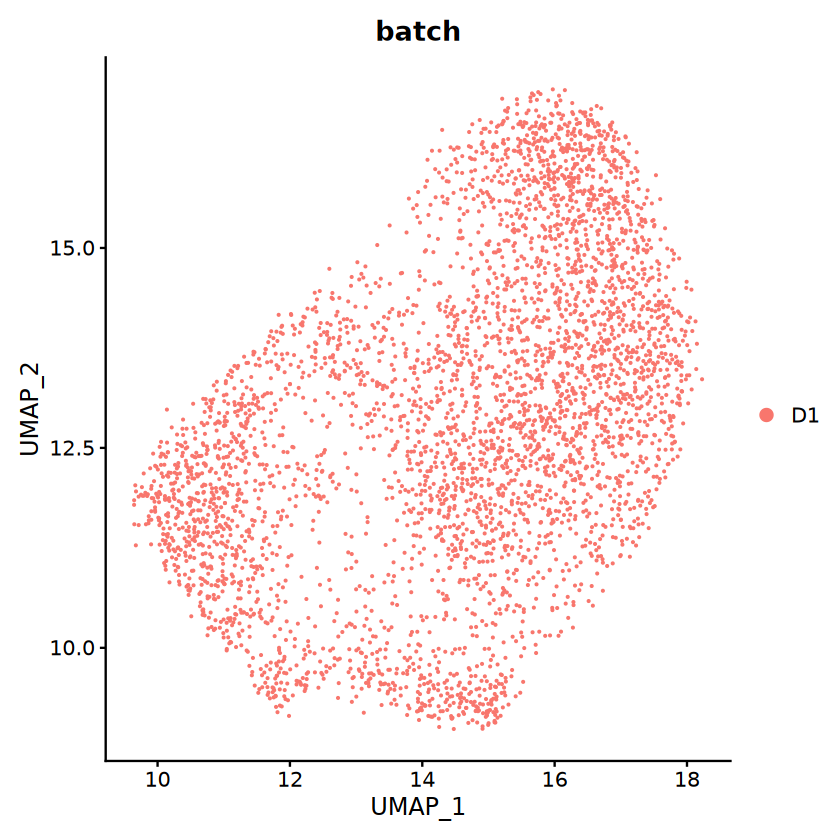

In [130]:
D1_single=CreateSeuratObject(counts = D1, min.cells = 0, min.features = 0, project = "ALL") 
D1_single@meta.data$batch='D1'
D1_single@meta.data$orig.ident=colData(spe_507)$'layer_guess'
D1_single=FindVariableFeatures(object = D1_single, selection.method = "vst", nfeatures = 2000)   
# VariableFeatures(object = pbmc_batch)
D1_single <- NormalizeData(object = D1_single, normalization.method = "LogNormalize", scale.factor = 10000)
D1_single <- ScaleData(object = D1_single, features = VariableFeatures(object = D1_single))
D1_single <- RunPCA(object = D1_single, seed.use=123, npcs=50, features = VariableFeatures(object = D1_single), ndims.print=1,nfeatures.print=1)
D1_single <- RunUMAP(D1_single, dims = 1:50, seed.use = 123,n.components=2, umap.method = "umap-learn",  metric="correlation")
DimPlot(D1_single, reduction='umap', group.by='batch', pt.size=0.1) 

In [132]:
# Create spatial assay and attach image
D1_single[["Spatial"]] <- CreateAssayObject(counts = D1_single[["RNA"]]@data)

sample_507_name <- '151507'
D1_single <- addImage(D1_single, sample_507_name, download_dir, new_name=glue("image_{sample_507_name}"))

image_151507


In [133]:
D1_single <- FindNeighbors(object = D1_single)

Computing nearest neighbor graph

Computing SNN



In [134]:
# Experiment on different resolutions when finding clusters
D1_single_05_res <- FindClusters(object = D1_single, resolution = 0.5)
D1_single_06_res <- FindClusters(object = D1_single, resolution = 0.6)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4226
Number of edges: 135717

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7941
Number of communities: 5
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4226
Number of edges: 135717

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7767
Number of communities: 7
Elapsed time: 0 seconds


In [135]:
D1_single_05_res_nona <- D1_single_05_res[,!is.na(D1_single_05_res$orig.ident)]
D1_single_06_res_nona <- D1_single_06_res[,!is.na(D1_single_06_res$orig.ident)]
D1_single_05_res_nona
D1_single_06_res_nona

An object of class Seurat 
67076 features across 4221 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

An object of class Seurat 
67076 features across 4221 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

In [136]:
score_05 <- ARI(D1_single_05_res_nona$seurat_clusters, D1_single_05_res_nona$orig.ident)
print(c('before batch effect removal D1 0.5 resolution (5 communities) ARI score: ', score_05))
score_06 <- ARI(D1_single_06_res_nona$seurat_clusters, D1_single_06_res_nona$orig.ident)
print(c('before batch effect removal D1 0.6 resolution (7 communities) ARI score: ', score_06))

[1] "before batch effect removal D1 0.5 resolution (5 communities) ARI score: "
[2] "0.301885688785338"                                                        
[1] "before batch effect removal D1 0.6 resolution (7 communities) ARI score: "
[2] "0.336207521836288"                                                        


In [137]:
options(repr.plot.width = 14, repr.plot.height = 7)

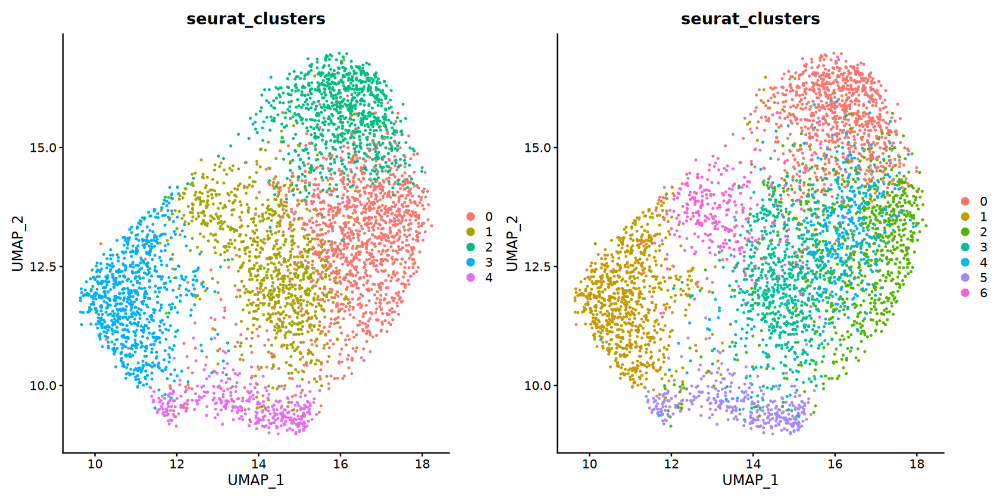

In [138]:
D1_05_dimplot <- DimPlot(D1_single_05_res_nona, reduction='umap', group.by='seurat_clusters')
D1_06_dimplot <- DimPlot(D1_single_06_res_nona, reduction='umap', group.by='seurat_clusters')
wrap_plots(D1_05_dimplot, D1_06_dimplot)

In [139]:
options(repr.plot.width = 21, repr.plot.height = 7)

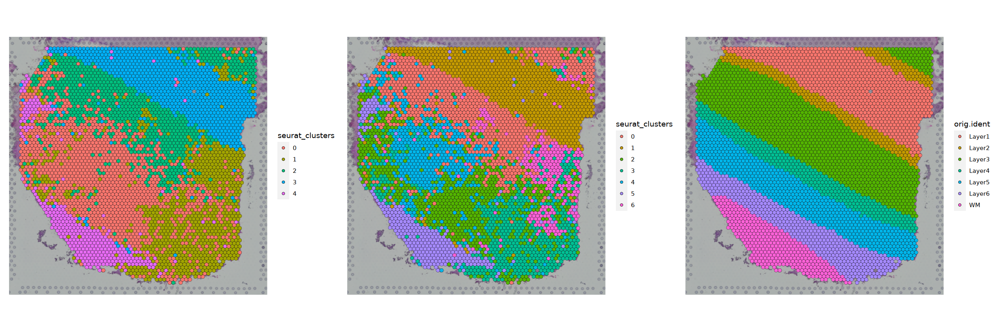

In [140]:
D1_single_05_res_plot_seurat <- SpatialDimPlot(D1_single_05_res_nona, group.by='seurat_clusters', label = FALSE, label.size = 7) + theme(legend.position = "right")
D1_single_06_res_plot_seurat <- SpatialDimPlot(D1_single_06_res_nona, group.by='seurat_clusters', label = FALSE, label.size = 7) + theme(legend.position = "right")
wrap_plots(D1_single_05_res_plot_seurat, D1_single_06_res_plot_seurat, D1_orig)

In [141]:
D1_single_path <- file.path(output_dir, output_D1)

jpeg(filename = file.path(D1_single_path, glue("{output_D1}_rna_05_res_151507.jpg")), height = 400, width = 470, quality = 100)
D1_single_05_res_plot_seurat
dev.off()
jpeg(filename = file.path(D1_single_path, glue("{output_D1}_rna_06_res_151507.jpg")), height = 400, width = 470, quality = 100)
D1_single_06_res_plot_seurat
dev.off()

png 
  2

png 
  2

In [142]:
# Set DefaultAssay to Spatial and perform spatial analysis using SCTransform for Normalization
DefaultAssay(D1_single) <- "Spatial"
D1_single <- SCTransform(D1_single, assay = "Spatial", return.only.var.genes = FALSE, verbose = FALSE)
D1_single <- RunPCA(D1_single, assay = "SCT", verbose = TRUE)
D1_single <- FindNeighbors(D1_single, reduction = "pca", dims = 1:30)
D1_single <- RunUMAP(D1_single, reduction = "pca", dims = 1:30, verbose = TRUE)

PC_ 1 
Positive:  ENSG00000131095, ENSG00000171885, ENSG00000182600, ENSG00000113140, ENSG00000026025, ENSG00000109846, ENSG00000099194, ENSG00000135744, ENSG00000170323, ENSG00000145824 
	   ENSG00000125144, ENSG00000167191, ENSG00000148180, ENSG00000164434, ENSG00000125148, ENSG00000173432, ENSG00000152661, ENSG00000163191, ENSG00000159176, ENSG00000103260 
	   ENSG00000175130, ENSG00000189171, ENSG00000170421, ENSG00000046653, ENSG00000019582, ENSG00000021300, ENSG00000166925, ENSG00000185499, ENSG00000266402, ENSG00000148671 
Negative:  ENSG00000104722, ENSG00000022355, ENSG00000133083, ENSG00000058404, ENSG00000213190, ENSG00000170091, ENSG00000100604, ENSG00000157087, ENSG00000197043, ENSG00000149269 
	   ENSG00000128564, ENSG00000107758, ENSG00000168993, ENSG00000173267, ENSG00000186462, ENSG00000081189, ENSG00000158856, ENSG00000121769, ENSG00000097021, ENSG00000264364 
	   ENSG00000174437, ENSG00000213585, ENSG00000221946, ENSG00000184524, ENSG00000166448, ENSG00000166922, ENS

In [143]:
# Experiment on different resolutions when finding clusters
D1_single_sct_09 <- FindClusters(D1_single, resolution = 0.9)
D1_single_sct_10 <- FindClusters(D1_single, resolution = 1.0)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4226
Number of edges: 192404

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6964
Number of communities: 7
Elapsed time: 0 seconds


1 singletons identified. 6 final clusters.



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4226
Number of edges: 192404

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6759
Number of communities: 8
Elapsed time: 0 seconds


1 singletons identified. 7 final clusters.



In [144]:
D1_single_sct_09_res_nona <- D1_single_sct_09[,!is.na(D1_single_sct_09$orig.ident)]
D1_single_sct_10_res_nona <- D1_single_sct_10[,!is.na(D1_single_sct_10$orig.ident)]
D1_single_sct_09_res_nona
D1_single_sct_10_res_nona

An object of class Seurat 
84327 features across 4221 samples within 3 assays 
Active assay: SCT (17251 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

An object of class Seurat 
84327 features across 4221 samples within 3 assays 
Active assay: SCT (17251 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151507

In [145]:
score_sct_09 <- ARI(D1_single_sct_09_res_nona$seurat_clusters, D1_single_sct_09_res_nona$orig.ident)
print(c('before batch effect removal D1 SCT 0.9 resolution (6 communities) ARI score: ', score_sct_09))
score_sct_10 <- ARI(D1_single_sct_10_res_nona$seurat_clusters, D1_single_sct_10_res_nona$orig.ident)
print(c('before batch effect removal D1 SCT 1.0 resolution (7 communities) ARI score: ', score_sct_10))

[1] "before batch effect removal D1 SCT 0.9 resolution (6 communities) ARI score: "
[2] "0.314293310003732"                                                            
[1] "before batch effect removal D1 SCT 1.0 resolution (7 communities) ARI score: "
[2] "0.317372929799327"                                                            


In [ ]:
options(repr.plot.width = 21, repr.plot.height = 7)
D1_single_sct_09_res_plot_seurat <- SpatialDimPlot(D1_single_sct_09_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D1_single_sct_10_res_plot_seurat <- SpatialDimPlot(D1_single_sct_10_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
wrap_plots(D1_single_sct_09_res_plot_seurat, D1_single_sct_10_res_plot_seurat, D1_orig)

In [147]:
D1_single_path <- file.path(output_dir, output_D1)

jpeg(filename = file.path(D1_single_path, glue("{output_D1}_sct_09_res_151507.jpg")), height = 400, width = 470, quality = 100)
D1_single_sct_09_res_plot_seurat
dev.off()
jpeg(filename = file.path(D1_single_path, glue("{output_D1}_sct_10_res_151507.jpg")), height = 400, width = 470, quality = 100)
D1_single_sct_10_res_plot_seurat
dev.off()

png 
  2

png 
  2

<h3>D2 (w/o spatial) only without batch effect removal

In [148]:
options(repr.plot.width = 7, repr.plot.height = 7)

Centering and scaling data matrix

PC_ 1 
Positive:  ENSG00000110484 
Negative:  ENSG00000212907 



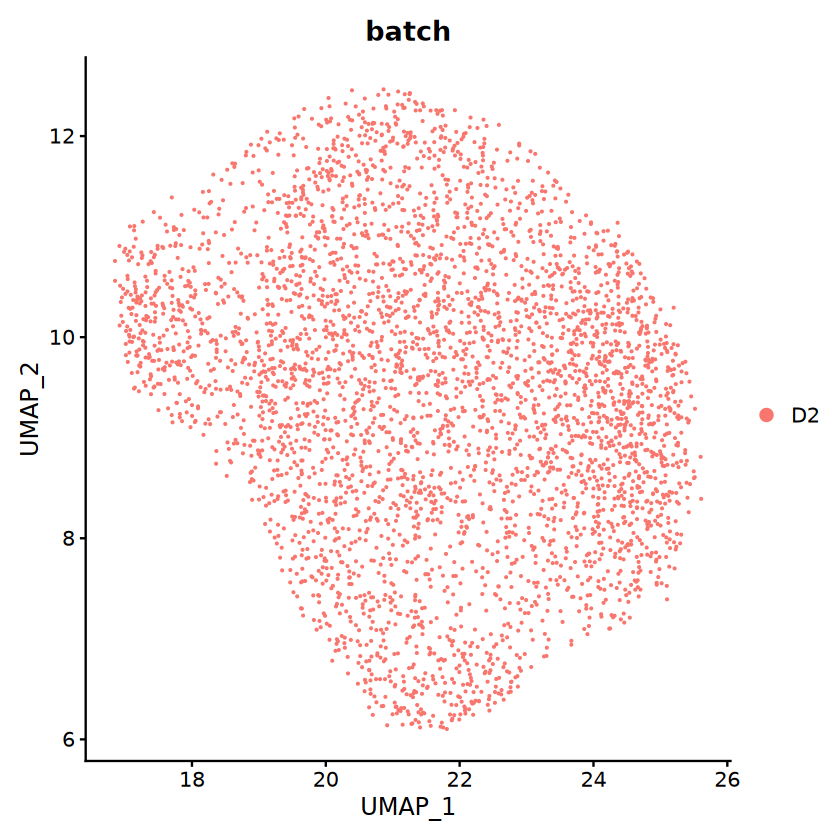

In [149]:
D2_single=CreateSeuratObject(counts = D2, min.cells = 0, min.features = 0, project = "ALL") 
D2_single@meta.data$batch='D2'
D2_single@meta.data$orig.ident=colData(spe_672)$'layer_guess'
D2_single=FindVariableFeatures(object = D2_single, selection.method = "vst", nfeatures = 2000)   
# VariableFeatures(object = pbmc_batch)
D2_single <- NormalizeData(object = D2_single, normalization.method = "LogNormalize", scale.factor = 10000)
D2_single <- ScaleData(object = D2_single, features = VariableFeatures(object = D2_single))
D2_single <- RunPCA(object = D2_single, seed.use=123, npcs=50, features = VariableFeatures(object = D2_single), ndims.print=1,nfeatures.print=1)
D2_single <- RunUMAP(D2_single, dims = 1:50, seed.use = 123,n.components=2, umap.method = "umap-learn",  metric="correlation")
DimPlot(D2_single, reduction='umap', group.by='batch', pt.size=0.1) 

In [150]:
# Create spatial assay and attach image
D2_single[["Spatial"]] <- CreateAssayObject(counts = D2_single[["RNA"]]@data)

sample_672_name <- '151672'
D2_single <- addImage(D2_single, sample_672_name, download_dir, new_name=glue("image_{sample_672_name}"))

image_151672


In [151]:
D2_single <- FindNeighbors(object = D2_single)

Computing nearest neighbor graph

Computing SNN



In [152]:
D2_single_04_res <- FindClusters(object = D2_single, resolution = 0.4)
D2_single_05_res <- FindClusters(object = D2_single, resolution = 0.5)
D2_single_06_res <- FindClusters(object = D2_single, resolution = 0.6)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 124992

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7673
Number of communities: 5
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 124992

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7433
Number of communities: 6
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 124992

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7239
Number of communities: 7
Elapsed time: 0 seconds


In [153]:
D2_single_04_res_nona <- D2_single_04_res[,!is.na(D2_single_04_res$orig.ident)]
D2_single_05_res_nona <- D2_single_05_res[,!is.na(D2_single_05_res$orig.ident)]
D2_single_06_res_nona <- D2_single_06_res[,!is.na(D2_single_06_res$orig.ident)]
D2_single_04_res_nona
D2_single_05_res_nona
D2_single_06_res_nona

An object of class Seurat 
67076 features across 3888 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
67076 features across 3888 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
67076 features across 3888 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

In [154]:
score_04 <- ARI(D2_single_04_res_nona$seurat_clusters, D2_single_04_res_nona$orig.ident)
print(c('before batch effect removal D2 0.4 resolution (5 communities) ARI score: ', score_04))
score_05 <- ARI(D2_single_05_res_nona$seurat_clusters, D2_single_05_res_nona$orig.ident)
print(c('before batch effect removal D2 0.5 resolution (6 communities) ARI score: ', score_05))
score_06 <- ARI(D2_single_06_res_nona$seurat_clusters, D2_single_06_res_nona$orig.ident)
print(c('before batch effect removal D2 0.6 resolution (7 communities) ARI score: ', score_06))

[1] "before batch effect removal D2 0.4 resolution (5 communities) ARI score: "
[2] "0.238767463870666"                                                        
[1] "before batch effect removal D2 0.5 resolution (6 communities) ARI score: "
[2] "0.238388643574871"                                                        
[1] "before batch effect removal D2 0.6 resolution (7 communities) ARI score: "
[2] "0.244248571653617"                                                        


In [155]:
options(repr.plot.width = 21, repr.plot.height = 7)

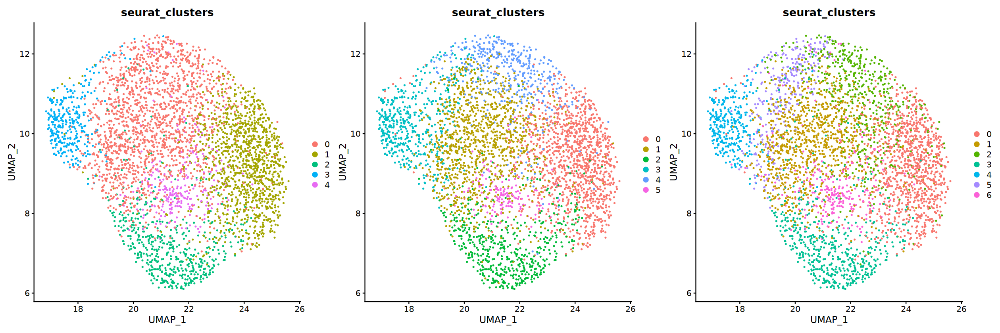

In [156]:
D2_04_dimplot <- DimPlot(D2_single_04_res_nona, reduction='umap', group.by='seurat_clusters')
D2_05_dimplot <- DimPlot(D2_single_05_res_nona, reduction='umap', group.by='seurat_clusters')
D2_06_dimplot <- DimPlot(D2_single_06_res_nona, reduction='umap', group.by='seurat_clusters')
wrap_plots(D2_04_dimplot, D2_05_dimplot, D2_06_dimplot)

In [157]:
options(repr.plot.width = 28, repr.plot.height = 7)

In [ ]:
D2_single_04_res_plot_seurat <- SpatialDimPlot(D2_single_04_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D2_single_05_res_plot_seurat <- SpatialDimPlot(D2_single_05_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D2_single_06_res_plot_seurat <- SpatialDimPlot(D2_single_06_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
wrap_plots(D2_single_04_res_plot_seurat, D2_single_05_res_plot_seurat, D2_single_06_res_plot_seurat, D2_orig, ncol=4)

In [159]:
D2_single_path <- file.path(output_dir, output_D2)

jpeg(filename = file.path(D2_single_path, glue("{output_D2}_rna_04_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_04_res_plot_seurat
dev.off()
jpeg(filename = file.path(D2_single_path, glue("{output_D2}_rna_05_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_05_res_plot_seurat
dev.off()
jpeg(filename = file.path(D2_single_path, glue("{output_D2}_rna_06_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_06_res_plot_seurat
dev.off()

png 
  2

png 
  2

png 
  2

In [160]:
# Set DefaultAssay to Spatial and perform spatial analysis
DefaultAssay(D2_single) <- "Spatial"
D2_single <- SCTransform(D2_single, assay = "Spatial", return.only.var.genes = FALSE, verbose = FALSE)
D2_single <- RunPCA(D2_single, assay = "SCT", verbose = TRUE)
D2_single <- FindNeighbors(D2_single, reduction = "pca", dims = 1:30)
D2_single <- RunUMAP(D2_single, reduction = "pca", dims = 1:30, verbose = TRUE)

PC_ 1 
Positive:  ENSG00000164326, ENSG00000125505, ENSG00000187186, ENSG00000204822, ENSG00000177875, ENSG00000237651, ENSG00000136099, ENSG00000119421, ENSG00000141504, ENSG00000099785 
	   ENSG00000157216, ENSG00000075151, ENSG00000123570, ENSG00000148672, ENSG00000102898, ENSG00000132432, ENSG00000196730, ENSG00000155816, ENSG00000231013, ENSG00000067221 
	   ENSG00000137364, ENSG00000198911, ENSG00000231133, ENSG00000091542, ENSG00000111269, ENSG00000184178, ENSG00000119682, ENSG00000173486, ENSG00000137055, ENSG00000169992 
Negative:  ENSG00000124935, ENSG00000170421, ENSG00000110484, ENSG00000163191, ENSG00000185499, ENSG00000106541, ENSG00000111057, ENSG00000171345, ENSG00000108821, ENSG00000176046 
	   ENSG00000111341, ENSG00000164692, ENSG00000160862, ENSG00000160182, ENSG00000160180, ENSG00000115461, ENSG00000234745, ENSG00000100219, ENSG00000159763, ENSG00000115414 
	   ENSG00000168542, ENSG00000165949, ENSG00000124939, ENSG00000113140, ENSG00000173467, ENSG00000211592, ENS

In [161]:
# Experiment on different resolutions when finding clusters
D2_single_sct_06 <- FindClusters(D2_single, resolution = 0.6)
D2_single_sct_08 <- FindClusters(D2_single, resolution = 0.8)
D2_single_sct_09 <- FindClusters(D2_single, resolution = 0.9)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 172357

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6998
Number of communities: 5
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 172357

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6483
Number of communities: 5
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4015
Number of edges: 172357

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6248
Number of communities: 6
Elapsed time: 0 seconds


In [162]:
D2_single_sct_06_res_nona <- D2_single_sct_06[,!is.na(D2_single_sct_06$orig.ident)]
D2_single_sct_08_res_nona <- D2_single_sct_08[,!is.na(D2_single_sct_08$orig.ident)]
D2_single_sct_09_res_nona <- D2_single_sct_09[,!is.na(D2_single_sct_09$orig.ident)]
D2_single_sct_06_res_nona
D2_single_sct_08_res_nona
D2_single_sct_09_res_nona

An object of class Seurat 
84630 features across 3888 samples within 3 assays 
Active assay: SCT (17554 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
84630 features across 3888 samples within 3 assays 
Active assay: SCT (17554 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

An object of class Seurat 
84630 features across 3888 samples within 3 assays 
Active assay: SCT (17554 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151672

In [163]:
score_sct_06 <- ARI(D2_single_sct_06_res_nona$seurat_clusters, D2_single_sct_06_res_nona$orig.ident)
print(c('before batch effect removal D2 SCT 0.6 resolution (5 communities) ARI score: ', score_sct_06))
score_sct_08 <- ARI(D2_single_sct_08_res_nona$seurat_clusters, D2_single_sct_08_res_nona$orig.ident)
print(c('before batch effect removal D2 SCT 0.8 resolution (5 communities) ARI score: ', score_sct_08))
score_sct_09 <- ARI(D2_single_sct_09_res_nona$seurat_clusters, D2_single_sct_09_res_nona$orig.ident)
print(c('before batch effect removal D2 SCT 0.9 resolution (6 communities) ARI score: ', score_sct_09))

[1] "before batch effect removal D2 SCT 0.6 resolution (5 communities) ARI score: "
[2] "0.116294447183779"                                                            
[1] "before batch effect removal D2 SCT 0.8 resolution (5 communities) ARI score: "
[2] "0.111203879628293"                                                            
[1] "before batch effect removal D2 SCT 0.9 resolution (6 communities) ARI score: "
[2] "0.128564719701001"                                                            


In [ ]:
options(repr.plot.width = 28, repr.plot.height = 7)
D2_single_sct_06_res_plot_seurat <- SpatialDimPlot(D2_single_sct_06_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D2_single_sct_08_res_plot_seurat <- SpatialDimPlot(D2_single_sct_08_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D2_single_sct_09_res_plot_seurat <- SpatialDimPlot(D2_single_sct_09_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
wrap_plots(D2_single_sct_06_res_plot_seurat, D2_single_sct_08_res_plot_seurat, D2_single_sct_09_res_plot_seurat, D2_orig, ncol=4)

In [165]:
D2_single_path <- file.path(output_dir, output_D2)

jpeg(filename = file.path(D2_single_path, glue("{output_D2}_sct_06_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_sct_06_res_plot_seurat
dev.off()
jpeg(filename = file.path(D2_single_path, glue("{output_D2}_sct_08_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_sct_08_res_plot_seurat
dev.off()
jpeg(filename = file.path(D2_single_path, glue("{output_D2}_sct_09_res_151672.jpg")), height = 400, width = 470, quality = 100)
D2_single_sct_09_res_plot_seurat
dev.off()

png 
  2

png 
  2

png 
  2

<h3>D3 (w/o spatial) only without batch effect removal

In [166]:
options(repr.plot.width = 7, repr.plot.height = 7)

Centering and scaling data matrix

PC_ 1 
Positive:  ENSG00000171617 
Negative:  ENSG00000168314 



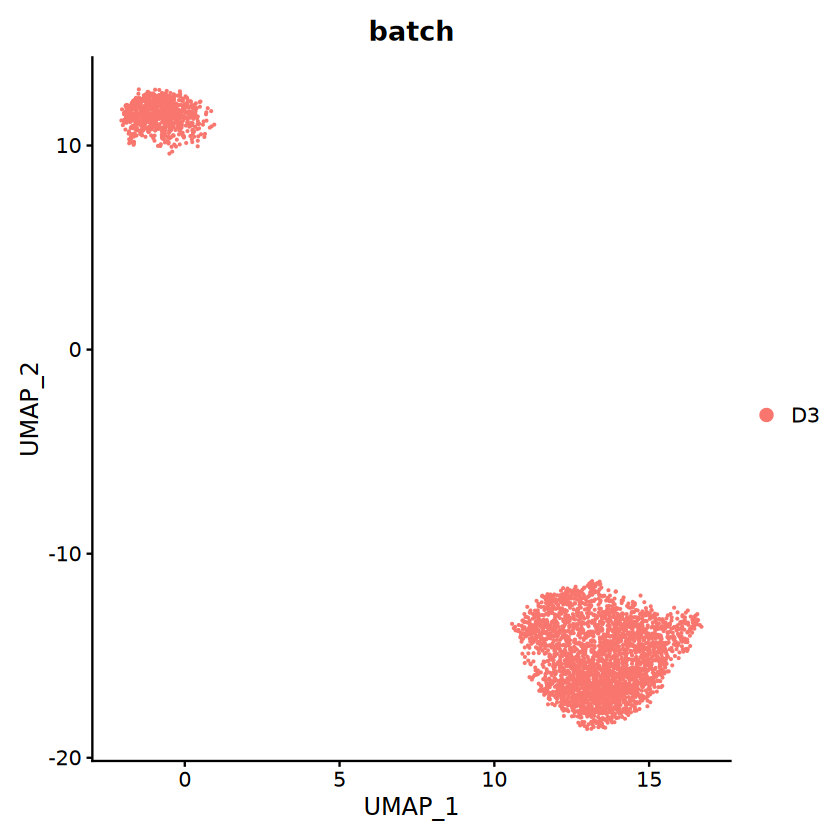

In [167]:
D3_single=CreateSeuratObject(counts = D3, min.cells = 0, min.features = 0, project = "ALL") 
D3_single@meta.data$batch='D3'
D3_single@meta.data$orig.ident=colData(spe_673)$'layer_guess'
D3_single=FindVariableFeatures(object = D3_single, selection.method = "vst", nfeatures = 2000)   
# VariableFeatures(object = pbmc_batch)
D3_single <- NormalizeData(object = D3_single, normalization.method = "LogNormalize", scale.factor = 10000)
D3_single <- ScaleData(object = D3_single, features = VariableFeatures(object = D3_single))
D3_single <- RunPCA(object = D3_single, seed.use=123, npcs=50, features = VariableFeatures(object = D3_single), ndims.print=1,nfeatures.print=1)
D3_single <- RunUMAP(D3_single, dims = 1:50, seed.use = 123,n.components=2, umap.method = "umap-learn",  metric="correlation")
DimPlot(D3_single, reduction='umap', group.by='batch', pt.size=0.1) 

In [168]:
# Create spatial assay and attach image
D3_single[["Spatial"]] <- CreateAssayObject(counts = D3_single[["RNA"]]@data)

sample_673_name <- '151673'
D3_single <- addImage(D3_single, sample_673_name, download_dir, new_name=glue("image_{sample_673_name}"))

image_151673


In [169]:
D3_single <- FindNeighbors(object = D3_single)

Computing nearest neighbor graph

Computing SNN



In [170]:
D3_single_06_res <- FindClusters(object = D3_single, resolution = 0.6)
D3_single_07_res <- FindClusters(object = D3_single, resolution = 0.7)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3639
Number of edges: 122436

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7683
Number of communities: 6
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3639
Number of edges: 122436

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7487
Number of communities: 7
Elapsed time: 0 seconds


In [171]:
D3_single_06_res_nona <- D3_single_06_res[,!is.na(D3_single_06_res$orig.ident)]
D3_single_07_res_nona <- D3_single_07_res[,!is.na(D3_single_07_res$orig.ident)]
D3_single_06_res_nona
D3_single_07_res_nona

An object of class Seurat 
67076 features across 3611 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

An object of class Seurat 
67076 features across 3611 samples within 2 assays 
Active assay: RNA (33538 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

In [172]:
score_06 <- ARI(D3_single_06_res_nona$seurat_clusters, D3_single_06_res_nona$orig.ident)
print(c('before batch effect removal D3 0.6 resolution (6 communities) ARI score: ', score_06))
score_07 <- ARI(D3_single_07_res_nona$seurat_clusters, D3_single_07_res_nona$orig.ident)
print(c('before batch effect removal D3 0.7 resolution (7 communities) ARI score: ', score_07))

[1] "before batch effect removal D3 0.6 resolution (6 communities) ARI score: "
[2] "0.230356682471039"                                                        
[1] "before batch effect removal D3 0.7 resolution (7 communities) ARI score: "
[2] "0.230880616837444"                                                        


In [173]:
options(repr.plot.width = 14, repr.plot.height = 7)

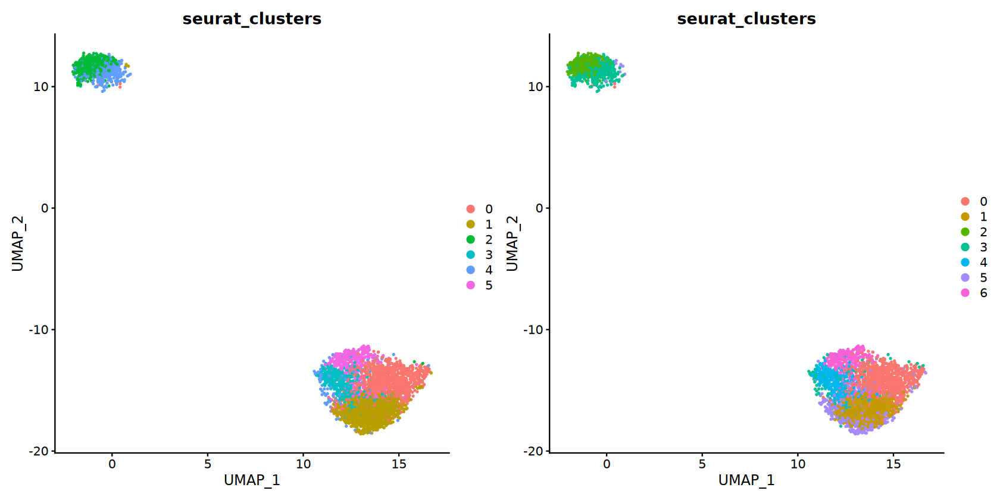

In [174]:
D3_06_dimplot <- DimPlot(D3_single_06_res_nona, reduction='umap', group.by='seurat_clusters')
D3_07_dimplot <- DimPlot(D3_single_07_res_nona, reduction='umap', group.by='seurat_clusters')
wrap_plots(D3_06_dimplot, D3_07_dimplot)

In [175]:
options(repr.plot.width = 21, repr.plot.height = 7)

In [ ]:
D3_single_06_res_plot_seurat <- SpatialDimPlot(D3_single_06_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D3_single_07_res_plot_seurat <- SpatialDimPlot(D3_single_07_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
wrap_plots(D3_single_06_res_plot_seurat, D3_single_07_res_plot_seurat, D3_orig, ncol=3)

In [177]:
D3_single_path <- file.path(output_dir, output_D3)

jpeg(filename = file.path(D3_single_path, glue("{output_D3}_rna_06_res_151673.jpg")), height = 400, width = 470, quality = 100)
D3_single_06_res_plot_seurat
dev.off()
jpeg(filename = file.path(D3_single_path, glue("{output_D3}_rna_07_res_151673.jpg")), height = 400, width = 470, quality = 100)
D3_single_07_res_plot_seurat
dev.off()


png 
  2

png 
  2

In [178]:
# Set DefaultAssay to Spatial and perform spatial analysis
DefaultAssay(D3_single) <- "Spatial"
D3_single <- SCTransform(D3_single, assay = "Spatial", return.only.var.genes = FALSE, verbose = FALSE)
D3_single <- RunPCA(D3_single, assay = "SCT", verbose = TRUE)
D3_single <- FindNeighbors(D3_single, reduction = "pca", dims = 1:30)
D3_single <- RunUMAP(D3_single, reduction = "pca", dims = 1:30, verbose = TRUE)

PC_ 1 
Positive:  ENSG00000100362, ENSG00000169851, ENSG00000157005, ENSG00000111341, ENSG00000186907, ENSG00000136750, ENSG00000118432, ENSG00000103154, ENSG00000084444, ENSG00000171992 
	   ENSG00000167733, ENSG00000198944, ENSG00000171303, ENSG00000154229, ENSG00000149926, ENSG00000144040, ENSG00000267673, ENSG00000186469, ENSG00000157540, ENSG00000143318 
	   ENSG00000143248, ENSG00000215788, ENSG00000116539, ENSG00000106348, ENSG00000112308, ENSG00000189056, ENSG00000092068, ENSG00000123570, ENSG00000105576, ENSG00000104361 
Negative:  ENSG00000105695, ENSG00000168314, ENSG00000136541, ENSG00000013297, ENSG00000204655, ENSG00000167641, ENSG00000172508, ENSG00000091513, ENSG00000126803, ENSG00000118785 
	   ENSG00000164124, ENSG00000172005, ENSG00000064787, ENSG00000250722, ENSG00000237949, ENSG00000148826, ENSG00000080822, ENSG00000136960, ENSG00000129538, ENSG00000197430 
	   ENSG00000102934, ENSG00000109099, ENSG00000066322, ENSG00000141540, ENSG00000160781, ENSG00000167755, ENS

In [179]:
# Experiment on different resolutions when finding clusters
D3_single_sct_11 <- FindClusters(D3_single, resolution = 1.1)
D3_single_sct_12 <- FindClusters(D3_single, resolution = 1.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3639
Number of edges: 184969

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6554
Number of communities: 6
Elapsed time: 0 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 3639
Number of edges: 184969

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6383
Number of communities: 7
Elapsed time: 0 seconds


In [180]:
D3_single_sct_11_res_nona <- D3_single_sct_11[,!is.na(D3_single_sct_11$orig.ident)]
D3_single_sct_12_res_nona <- D3_single_sct_12[,!is.na(D3_single_sct_12$orig.ident)]
D3_single_sct_11_res_nona
D3_single_sct_12_res_nona

An object of class Seurat 
85087 features across 3611 samples within 3 assays 
Active assay: SCT (18011 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

An object of class Seurat 
85087 features across 3611 samples within 3 assays 
Active assay: SCT (18011 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 2 other assays present: RNA, Spatial
 2 dimensional reductions calculated: pca, umap
 1 image present: image_151673

In [181]:
score_sct_11 <- ARI(D3_single_sct_11_res_nona$seurat_clusters, D3_single_sct_11_res_nona$orig.ident)
print(c('before batch effect removal D3 SCT 1.1 resolution (6 communities) ARI score: ', score_sct_11))
score_sct_12 <- ARI(D3_single_sct_12_res_nona$seurat_clusters, D3_single_sct_12_res_nona$orig.ident)
print(c('before batch effect removal D3 SCT 1.2 resolution (7 communities) ARI score: ', score_sct_12))

[1] "before batch effect removal D3 SCT 1.1 resolution (6 communities) ARI score: "
[2] "0.178136354700483"                                                            
[1] "before batch effect removal D3 SCT 1.2 resolution (7 communities) ARI score: "
[2] "0.18812628592868"                                                             


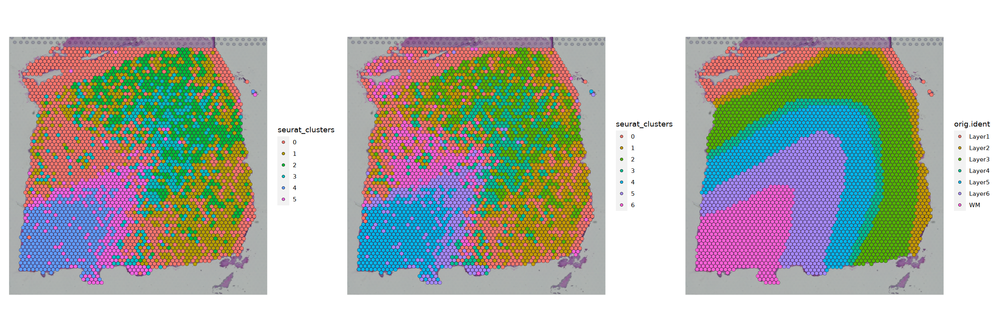

In [182]:
options(repr.plot.width = 21, repr.plot.height = 7)
D3_single_sct_11_res_plot_seurat <- SpatialDimPlot(D3_single_sct_11_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
D3_single_sct_12_res_plot_seurat <- SpatialDimPlot(D3_single_sct_12_res_nona, group.by='seurat_clusters') + theme(legend.position = "right")
wrap_plots(D3_single_sct_11_res_plot_seurat, D3_single_sct_12_res_plot_seurat, D3_orig, ncol=3)

In [183]:
D3_single_path <- file.path(output_dir, output_D3)

jpeg(filename = file.path(D3_single_path, glue("{output_D3}_sct_11_res_151673.jpg")), height = 400, width = 470, quality = 100)
D3_single_sct_11_res_plot_seurat
dev.off()
jpeg(filename = file.path(D3_single_path, glue("{output_D3}_sct_12_res_151673.jpg")), height = 400, width = 470, quality = 100)
D3_single_sct_12_res_plot_seurat
dev.off()

png 
  2

png 
  2